## Upload baseline predictions

In [ ]:
# upload baseline predictions
! mkdir baseline

! rm -rf baseline/predictions
! unzip baseline-predictions.zip > /dev/null
# NOTE baseline-predictions.zip expands to predictions/
! mv predictions baseline/

## Upload optimization predictions

In [ ]:
# Separate directory for optimization summary files
! mkdir optimized

! rm -rf optimized/predictions
! unzip optimized-predictions.zip > /dev/null
# NOTE optimized-predictions.zip expands to predictions/
! mv predictions optimized/

## Utility Functions

In [ ]:
! pip install geopandas > /dev/null
! pip install folium > /dev/null

import matplotlib as mpl
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
from pathlib import Path
import geopandas as gpd
import folium
import seaborn as sns
import branca.colormap as cm
sns.set(font_scale=2.0)

np.warnings.filterwarnings('ignore', category=np.VisibleDeprecationWarning)
pd.options.mode.chained_assignment = None

def getPredictionFilename(crop, country, nuts_level,
                          early_season=False, early_season_end=0):
  """Return name of prediction file based on our convention"""
  pred_file = 'pred_' + crop.replace(' ', '_') + '_' + country
  pred_file += '_' + nuts_level + '_trend'
  if early_season:
    pred_file += '_early' + str(early_season_end)

  pred_file += '.csv'
  return pred_file

def readRegionalPredictions(baseline_dir, optim_dir, crops, country_nuts,
                            early_season=False, early_season_end=0, debug_level=0):
  """Read regional prediction files for baseline and optimization"""
  mlb_pred_dfs = {}
  opt_pred_dfs = {}
  for cr in crops:
    mlb_crop_df = None
    opt_crop_df = None
    for cn in country_nuts:
      nuts_level = country_nuts[cn]
      pred_file = getPredictionFilename(cr, cn, nuts_level,
                                        early_season, early_season_end)
      mlb_pred_file = baseline_dir + '/predictions/all-' + cn + '/' + pred_file
      opt_pred_file = optim_dir  + '/predictions/all-' + cn + '/' + pred_file
      file_check1 = Path(mlb_pred_file)
      file_check2 = Path(opt_pred_file)

      if (debug_level > 2):
        print(mlb_pred_file, ' check:', file_check1.exists())
        print(opt_pred_file, ' check:', file_check2.exists())

      if ((not file_check1.exists()) or (not file_check2.exists())):
        continue

      mlb_crcn_df = pd.read_csv(mlb_pred_file, header=0)
      opt_crcn_df = pd.read_csv(opt_pred_file, header=0)
      if (mlb_crop_df is None):
        mlb_crop_df = mlb_crcn_df
      else:
        mlb_crop_df = mlb_crop_df.append(mlb_crcn_df)

      if (opt_crop_df is None):
        opt_crop_df = opt_crcn_df
      else:
        opt_crop_df = opt_crop_df.append(opt_crcn_df)

    mlb_pred_dfs[cr] = mlb_crop_df
    opt_pred_dfs[cr] = opt_crop_df

  return mlb_pred_dfs, opt_pred_dfs

def readNUTS0Predictions(baseline_dir, optim_dir, crops, countries,
                         early_season=False, early_season_end=0, debug_level=0):
  """Read national prediction files for baseline and optimization"""
  mlb_pred_dfs = {}
  opt_pred_dfs = {}
  nuts_level = 'NUTS0'
  for cr in crops:
    mlb_crop_df = None
    opt_crop_df = None
    for cn in countries:
      pred_file = getPredictionFilename(cr, cn, nuts_level,
                                        early_season, early_season_end)
      mlb_pred_file = baseline_dir + '/predictions/all-' + cn + '/' + pred_file
      opt_pred_file = optim_dir  + '/predictions/all-' + cn + '/' + pred_file
      file_check1 = Path(mlb_pred_file)
      file_check2 = Path(opt_pred_file)

      if (debug_level > 2):
        print(mlb_pred_file, ' check:', file_check1.exists())
        print(opt_pred_file, ' check:', file_check2.exists())

      if ((not file_check1.exists()) or (not file_check2.exists())):
        continue

      mlb_crcn_df = pd.read_csv(mlb_pred_file, header=0)
      opt_crcn_df = pd.read_csv(opt_pred_file, header=0)
      if (mlb_crop_df is None):
        mlb_crop_df = mlb_crcn_df
      else:
        mlb_crop_df = mlb_crop_df.append(mlb_crcn_df)

      if (opt_crop_df is None):
        opt_crop_df = opt_crcn_df
      else:
        opt_crop_df = opt_crop_df.append(opt_crcn_df)

    mlb_pred_dfs[cr] = mlb_crop_df
    opt_pred_dfs[cr] = opt_crop_df

  return mlb_pred_dfs, opt_pred_dfs

def getNUTSGeoPandasData(countries, nuts_level):
  if (isinstance(countries, str)):
    countries = [countries]

  nuts_map_source = 'https://gisco-services.ec.europa.eu/distribution/v2/nuts/geojson'
  geojson_file = 'NUTS_RG_03M_2016_4326_LEVL_' + nuts_level[-1] + '.geojson'

  geo_pd_nutsx = gpd.read_file(nuts_map_source + '/' + geojson_file)
  geo_pd_nutsx = geo_pd_nutsx.drop(columns=['id', 'LEVL_CODE', 'FID'])
  geo_pd_nutsx = geo_pd_nutsx.rename(columns={ 'CNTR_CODE' : 'COUNTRY'} )
  geo_pd_nutsx = geo_pd_nutsx[geo_pd_nutsx['COUNTRY'].isin(countries)]

  return geo_pd_nutsx

def getMLPredictionsCropCountry(predictions_dir, crop, country, nuts_level,
                                early_season=False, early_season_end=0, debug_level=0):
  """Get predictions for given crop, country and machine learning algorithm"""
  pred_file = getPredictionFilename(crop, country, nuts_level,
                                    early_season, early_season_end)

  pred_full_path = predictions_dir + '/predictions/all-' + country + '/' + pred_file
  file_check = Path(pred_full_path)
  if (debug_level > 2):
    print(pred_full_path, ' check:', file_check.exists())

  if (not file_check.exists()):
    return None

  pd_preds_df = pd.read_csv(pred_full_path, header=0)
  pd_preds_df = pd_preds_df.rename(columns={ 'IDREGION' : 'NUTS_ID'})
  return pd_preds_df

def printDataFrame(pd_df, order_cols, max_entries, print_label):
  print(print_label)
  print(pd_df.sort_values(by=order_cols).head(max_entries).to_string(index=False))

# This definition is from the suggested answer to:
# https://stats.stackexchange.com/questions/58391/mean-absolute-percentage-error-mape-in-scikit-learn/294069#294069
def meanAbsolutePercentageError(Y_true, Y_pred):
  """Mean Absolute Percentage Error"""
  Y_true, Y_pred = np.array(Y_true), np.array(Y_pred)
  return np.mean(np.abs((Y_true - Y_pred) / Y_true)) * 100

def getPredictionMetrics(Y_true, Y_predicted, metrics):
  """Get values of metrics for given Y_predicted and Y_true"""
  pred_scores = {}

  for met in metrics:
    score_function = metrics[met]
    met_score = score_function(Y_true, Y_predicted)
    # for RMSE, score_function is mean_squared_error, take square root
    # normalize RMSE
    if (met == 'RMSE'):
      met_score = np.round(100*np.sqrt(met_score)/np.mean(Y_true), 3)
      pred_scores['NRMSE'] = met_score
    # normalize mean absolute errors except MAPE which is already a percentage
    elif ((met == 'MAE') or (met == 'MdAE')):
      met_score = np.round(100*met_score/np.mean(Y_true), 3)
      pred_scores['N' + met] = met_score
    # MAPE, R2, ... : no postprocessing
    else:
      met_score = np.round(met_score, 3)
      pred_scores[met] = met_score

  return pred_scores

def getPredictionSummaryRow(pd_df, crop, country, pred_col, pred_col_alias, metrics_functions):
  Y_true = pd_df['YIELD'].values
  Y_pred = pd_df[pred_col].values
  pred_metrics = getPredictionMetrics(Y_true, Y_pred, metrics_functions)
  pred_row = [crop, country, pred_col_alias]
  for met in pred_metrics:
    pred_row.append(pred_metrics[met])

  return pred_row

def getRegionalPredictionSummary(pd_df, crop, country, ml_algorithms, metrics_functions,
                                 pred_summary=None):
  if (pred_summary is None):
    pred_summary = {}

  row_idx = len(pred_summary)
  # trend predictions
  trend_row = getPredictionSummaryRow(pd_df, crop, country, 'YIELD_TREND', 'TREND',
                                      metrics_functions)
  pred_summary['row' + str(row_idx)] = trend_row
  row_idx += 1

  # ML predictions
  for alg in ml_algorithms:
    alg_row = getPredictionSummaryRow(pd_df, crop, country, 'YIELD_PRED_' + alg, alg,
                                      metrics_functions)
    pred_summary['row' + str(row_idx)] = alg_row
    row_idx += 1

  return pred_summary

def getNUTS0PredictionSummary(pd_df, crop, country, ml_algorithms, metrics_functions,
                              pred_summary=None):
  if (pred_summary is None):
    pred_summary = {}

  row_idx = len(pred_summary)
  Y_true = pd_df['YIELD'].values
  for alg in ml_algorithms:
    alg_row = getPredictionSummaryRow(pd_df, crop, country, 'YIELD_PRED_' + alg, alg,
                                      metrics_functions)
    pred_summary['row' + str(row_idx)] = alg_row
    row_idx += 1

  # MCYFS predictions
  mcyfs_row = getPredictionSummaryRow(pd_df, crop, country, 'YIELD_PRED_MCYFS', 'MCYFS',
                                      metrics_functions)
  pred_summary['row' + str(row_idx)] = mcyfs_row

  return pred_summary

def getSelectedMLAlgorithm(crop, country, pd_sum_df, debug_level=0, debug_message=''):
  """For given crop, country, return the algorithm selected (based on NRMSE)"""
  crop_country_filter = (pd_sum_df['CROP'] == crop) & (pd_sum_df['COUNTRY'] == country)
  ml_alg_filter = (pd_sum_df['ALGORITHM'] != 'TREND') & (pd_sum_df['ALGORITHM'] != 'MCYFS')
  ml_alg = pd_sum_df[crop_country_filter & ml_alg_filter]['ALGORITHM'].values[0]
  if (debug_level > 2):
      print(crop, country, debug_message + ':', ml_alg)

  return ml_alg

def getSelectedMLAlgorithmMulti(crop, country, pd_sum_dfs, debug_level, debug_message):
  """
  For given crop, country, return the algorithm selected (based on NRMSE).
  Works for a list of summary dataframes.
  """
  sel_ml_algs = []
  for i in range(len(pd_sum_dfs)):
    pd_df = pd_sum_dfs[i]
    crop_country_filter = (pd_df['CROP'] == crop) & (pd_df['COUNTRY'] == country)
    ml_alg_filter = (pd_df['ALGORITHM'] != 'TREND') & (pd_df['ALGORITHM'] != 'MCYFS')
    ml_alg = pd_df[crop_country_filter & ml_alg_filter]['ALGORITHM'].values[0]
    sel_ml_algs.append(ml_alg)
    if (debug_level > 2):
      print(crop, country, debug_message[i] + ':', ml_alg)

  return sel_ml_algs

def selectTrendPlusMinRMSEMLAlgorithm(pd_df):
  trend_pred_df = pd_df[pd_df['ALGORITHM'] == 'TREND']
  pd_df = pd_df[pd_df['ALGORITHM'] != 'TREND']
  pd_df = pd_df[pd_df['NRMSE'] == pd_df.groupby(['CROP', 'COUNTRY'])['NRMSE'].transform('min')]
  pd_df = pd_df.append(trend_pred_df)

  return pd_df

def selectMCYFSPlusMinRMSEMLAlgorithm(pd_df):
  mcyfs_pred_df = pd_df[pd_df['ALGORITHM'] == 'MCYFS']
  pd_df = pd_df[pd_df['ALGORITHM'] != 'MCYFS']
  pd_df = pd_df[pd_df['NRMSE'] == pd_df.groupby(['CROP', 'COUNTRY'])['NRMSE'].transform('min')]
  pd_df = pd_df.append(mcyfs_pred_df)

  return pd_df

def selectMinRMSEMLAlgorithm(crop, country, nuts_level, pd_preds_df, ml_algs,
                             metrics_functions, summary_columns):
  if (nuts_level == 'NUTS0'):
    preds_summary = getNUTS0PredictionSummary(pd_preds_df, crop, country,
                                              ml_algs, metrics_functions)
  else:
    preds_summary = getRegionalPredictionSummary(pd_preds_df, crop, country,
                                                 ml_algs, metrics_functions)

  pd_sum_df = pd.DataFrame.from_dict(preds_summary, orient='index',
                                     columns=summary_columns)
  if (nuts_level == 'NUTS0'):
    pd_sum_df = selectMCYFSPlusMinRMSEMLAlgorithm(pd_sum_df)
  else:
    pd_sum_df = selectTrendPlusMinRMSEMLAlgorithm(pd_sum_df)

  ml_alg = getSelectedMLAlgorithm(crop, country, pd_sum_df)

  if (nuts_level == 'NUTS0'):
    pd_preds_df = pd_preds_df[['NUTS_ID', 'FYEAR', 'YIELD_PRED_MCYFS', 'YIELD_PRED_' + ml_alg, 'YIELD']]
    pd_preds_df['MCYFS_RES'] = pd_preds_df['YIELD_PRED_MCYFS'] - pd_preds_df['YIELD']
    pd_preds_df['MCYFS_RES'] = 100 * (pd_preds_df['MCYFS_RES'] / pd_preds_df['YIELD'])
  else:
    pd_preds_df = pd_preds_df[['NUTS_ID', 'FYEAR', 'YIELD_TREND', 'YIELD_PRED_' + ml_alg, 'YIELD']]
    pd_preds_df['TREND_RES'] = pd_preds_df['YIELD_TREND'] - pd_preds_df['YIELD']
    pd_preds_df['TREND_RES'] = 100 * (pd_preds_df['TREND_RES'] / pd_preds_df['YIELD'])

  pd_preds_df = pd_preds_df.rename(columns={ 'YIELD_PRED_' + ml_alg : 'YIELD_PRED' })
  pd_preds_df['PRED_RES'] = pd_preds_df['YIELD_PRED'] - pd_preds_df['YIELD']
  pd_preds_df['PRED_RES'] = 100 * (pd_preds_df['PRED_RES'] / pd_preds_df['YIELD'])

  if (nuts_level == 'NUTS0'):
    pd_preds_df['COUNTRY'] = pd_preds_df['NUTS_ID']
  else:
    pd_preds_df['COUNTRY'] = pd_preds_df['NUTS_ID'].str[:2]

  return pd_preds_df, ml_alg

def plotRegionalSummaryMetrics(crop_countries, metrics_names,
                               mlb_met_df, opt_met_df,
                               title_label, bar_labels):
  ind = np.arange(len(crop_countries))
  bar_width = 0.2
  num_plots = len(metrics_names)

  fig, axs = plt.subplots(1, num_plots, sharex='all', sharey='none',
                          figsize=(32,8))
  for i in range(num_plots):
    met = metrics_names[i]
    trend_met_values = opt_met_df[opt_met_df['ALGORITHM'] == 'TREND'][met].values
    mlb_met_values = mlb_met_df[mlb_met_df['ALGORITHM'] != 'TREND'][met].values
    opt_met_values = opt_met_df[opt_met_df['ALGORITHM'] != 'TREND'][met].values
    sel_ax = axs if (num_plots == 1) else axs[i]
    sel_ax.bar(ind - bar_width, trend_met_values,
               bar_width - 0.02, color='blue', label=bar_labels[0])
    sel_ax.bar(ind, mlb_met_values,
               bar_width - 0.02, color='red', label=bar_labels[1])
    sel_ax.bar(ind + bar_width, opt_met_values,
               bar_width - 0.02, color='orange', label=bar_labels[2])

    sel_ax.set_ylabel(met)
    sel_ax.set_facecolor('w')
    sel_ax.grid(color='gray')

    ymax = max([max(trend_met_values), max(mlb_met_values), max(opt_met_values)])
    ymax = np.ceil(ymax/10) * 10
    sel_ax.set_ylim((0, ymax))
    sel_ax.set_title(title_label)
    sel_ax.set_xlabel("Country")
    sel_ax.legend(loc="upper right")

  plt.xticks(ind, crop_countries)
  plt.show()

def plotRegionalMetricsOnMap(crop_countries, metrics_names,
                             geo_pd_df, map_limits, country_xy,
                             mlb_met_dfs, opt_met_dfs,
                             title_labels, bar_labels):

  num_plots = len(title_labels)
  geo_sum_dfs = []
  for i in range(num_plots):
    mlb_df = mlb_met_dfs[i]
    opt_df = opt_met_dfs[i]

    met_sum_dict = {}
    row_idx = 0
    for cn in crop_countries:
      trend_met_values = opt_df[(opt_df['COUNTRY'] == cn) &
                                (opt_df['ALGORITHM'] == 'TREND')]['NRMSE'].values
      mlb_met_values = mlb_df[(mlb_df['COUNTRY'] == cn) &
                              (mlb_df['ALGORITHM'] != 'TREND')]['NRMSE'].values
      opt_met_values = opt_df[(opt_df['COUNTRY'] == cn) &
                              (opt_df['ALGORITHM'] != 'TREND')]['NRMSE'].values

      cn_row = []
      if ((trend_met_values[0] < mlb_met_values[0]) and
          (trend_met_values[0] < opt_met_values[0])):
        cn_row = [cn, 'blue']
      elif (mlb_met_values[0] < opt_met_values[0]):
        cn_row = [cn, 'red']
      else:
        cn_row = [cn, 'orange']

      cn_row += [trend_met_values[0], mlb_met_values[0], opt_met_values[0]]
      met_sum_dict['row' + str(row_idx)] = cn_row
      row_idx += 1

    summary_cols = ['COUNTRY', 'COLOR', 'TREND', 'MLB', 'MLOPT']
    pd_mets_df = pd.DataFrame.from_dict(met_sum_dict, orient='index',
                                        columns=summary_cols)

    # join with geo_pd_df
    geo_pd_sum_df = geo_pd_df.copy()
    geo_pd_sum_df = geo_pd_sum_df.merge(pd_mets_df, on=['COUNTRY'])
    geo_sum_dfs.append(geo_pd_sum_df)

  fig, axs = plt.subplots(1, num_plots, sharex='all', sharey='none',
                          figsize=(40, 15))
  for i in range(num_plots):
    sel_ax = axs[i]
    sel_geo_df = geo_sum_dfs[i]
    sel_ax.set_xlim(map_limits['xmin'], map_limits['xmax'])
    sel_ax.set_ylim(map_limits['ymin'], map_limits['ymax'])
    sel_geo_df.apply(lambda x: sel_ax.annotate(s=x.COUNTRY, xy=country_xy[x.COUNTRY], ha='center',
                                               **{ 'fontsize' : 16, 'fontweight' : 'bold' }),
                     axis=1);
    sel_ax.set_title(title_labels[i])
    base = sel_geo_df.plot(ax=sel_ax, color=sel_geo_df['COLOR'])
    geo_pd_nuts0_df.plot(ax=base, edgecolor='gray', linewidth=1.0, facecolor='none')

    ind = np.arange(1)
    bar_width = 0.2
    for cn in crop_countries:
      cnx = (country_xy[cn][0] - map_limits['xmin'])/(map_limits['xmax'] - map_limits['xmin'])
      cny = (country_xy[cn][1] + 0.5 - map_limits['ymin'])/(map_limits['ymax'] - map_limits['ymin'])
      trend_met_values = sel_geo_df[sel_geo_df['COUNTRY'] == cn]['TREND'].values
      mlb_met_values = sel_geo_df[sel_geo_df['COUNTRY'] == cn]['MLB'].values
      opt_met_values = sel_geo_df[sel_geo_df['COUNTRY'] == cn]['MLOPT'].values
      inset_ax = sel_ax.inset_axes((cnx, cny, 0.04, 0.08))
      inset_ax.bar(ind - bar_width, trend_met_values, bar_width - 0.02,
                   color='blue', edgecolor='black', label=bar_labels[0])
      inset_ax.bar(ind, mlb_met_values, bar_width - 0.02,
                   color='red', edgecolor='black', label=bar_labels[1])
      inset_ax.bar(ind + bar_width, opt_met_values, bar_width - 0.02,
                   color='orange', edgecolor='black', label=bar_labels[2])
      inset_ax.set_axis_off()

  plt.show()

def plotNUTS0SummaryMetrics(crop_countries, metrics_names,
                            mlb_met_df, opt_met_df,
                            title_label, bar_labels):
  ind = np.arange(len(crop_countries))
  bar_width = 0.2

  num_plots = len(metrics_names)

  fig, axs = plt.subplots(1, num_plots, sharex='all', sharey='none',
                         figsize=(32,8))
  for i in range(num_plots):
    met = metrics_names[i]
    mlb_met_values = mlb_met_df[mlb_met_df['ALGORITHM'] != 'MCYFS'][met].values
    opt_met_values = opt_met_df[opt_met_df['ALGORITHM'] != 'MCYFS'][met].values
    mcyfs_met_values = opt_met_df[opt_met_df['ALGORITHM'] == 'MCYFS'][met].values
    sel_ax = axs if (num_plots == 1) else axs[i]
    sel_ax.bar(ind - bar_width, mcyfs_met_values,
               bar_width - 0.02, color='blue', label=bar_labels[0])
    sel_ax.bar(ind, mlb_met_values,
               bar_width - 0.02, color='red', label=bar_labels[1])
    sel_ax.bar(ind + bar_width, opt_met_values,
               bar_width - 0.02, color='orange', label=bar_labels[2])

    sel_ax.set_ylabel(met)
    sel_ax.set_facecolor('w')
    sel_ax.grid(color='gray')
    ymax = max([max(mlb_met_values), max(opt_met_values), max(mcyfs_met_values)])
    ymax = np.ceil(ymax/10) * 10

    sel_ax.set_ylim((0, ymax))
    sel_ax.set_title(title_label)
    sel_ax.set_xlabel("Country")
    sel_ax.legend(loc="upper right")

  plt.xticks(ind, crop_countries)
  plt.show()

def plotRegionalReportedVSPredicted(crop, country, pd_pred_dfs, ml_algs, title_labels):
  """Plot actual and predicted values"""
  num_plots = len(pd_pred_dfs) + 1
  fig_title = crop.title() + '(' + country + ') : Actual vs Predicted'
  fig, axs = plt.subplots(1, num_plots, figsize=(32,8))
  font = {
      'color':  'black',
      'weight': 'bold',
      'size': 24,
  }

  # plot YIELD_TREND
  sel_pred_df = pd_pred_dfs[0]
  assert (num_plots > 1)
  sel_ax = axs[0]
  Y_true = sel_pred_df['YIELD'].values
  Y_pred = sel_pred_df['YIELD_TREND'].values
  min_val = Y_true.min() if (Y_pred.min() >= Y_true.min()) else Y_pred.min()
  max_val = Y_true.max() if (Y_pred.max() < Y_true.max()) else Y_pred.max()
  sel_ax.scatter(Y_true, Y_pred)
  sel_ax.plot([min_val, max_val], [min_val, max_val], 'k--', lw=4)
  sel_ax.set_xlabel('Actual', fontdict=font)
  sel_ax.set_ylabel('YIELD TREND', fontdict=font)
  sel_ax.set_title(title_labels[0])

  for i in range(len(pd_pred_dfs)):
    sel_pred_df = pd_pred_dfs[i]
    sel_alg = ml_algs[i]
    sel_ax = axs[i+1]
    Y_true = sel_pred_df['YIELD'].values
    Y_pred = sel_pred_df['YIELD_PRED_' + sel_alg].values
    min_val = Y_true.min() if (Y_pred.min() >= Y_true.min()) else Y_pred.min()
    max_val = Y_true.max() if (Y_pred.max() < Y_true.max()) else Y_pred.max()
    sel_ax.scatter(Y_true, Y_pred)
    sel_ax.plot([min_val, max_val], [min_val, max_val], 'k--', lw=4)
    sel_ax.set_xlabel('Actual', fontdict=font)
    sel_ax.set_ylabel(sel_alg + ' Predictions', fontdict=font)
    sel_ax.set_title(title_labels[i+1], fontsize=24)

  fig.suptitle(fig_title, fontsize=24, fontweight='bold')
  plt.show()

def plotNUTS0ReportedVSPredicted(crop, country, pd_preds_df, ml_algs, optim, title_labels):
  """Plot actual and predicted values"""
  num_plots = 2
  fig_title = crop.title() + '(' + country + ') : Actual vs Predicted'
  fig, axs = plt.subplots(1, num_plots, figsize=(40,15))
  font = {
      'color':  'black',
      'weight': 'bold',
      'size': 28,
  }

  # plot baseline and optimization
  for i in range(num_plots):
    mlb_preds_df = pd_preds_df[i][0]
    opt_preds_df = pd_preds_df[i][1]
    sel_alg_mlb = ml_algs[i][0]
    sel_alg_opt = ml_algs[i][1]
    sel_ax = axs[i]
    Y_true = mlb_preds_df['YIELD'].values
    all_years = opt_preds_df['FYEAR'].values
    Y_pred_mcyfs = opt_preds_df['YIELD_PRED_MCYFS'].values
    # Y_pred_mlb = mlb_preds_df['YIELD_PRED_' + sel_alg_mlb].values
    Y_pred_opt = opt_preds_df['YIELD_PRED_' + sel_alg_opt].values

    sel_ax.plot(all_years, Y_true[:len(all_years)], color='gray', marker='o', linestyle='dashed',
                linewidth=2, markersize=12, label='Yield')
    sel_ax.plot(all_years, Y_pred_mcyfs[:len(all_years)], color='blue', marker='x', linestyle='dashed',
                linewidth=2, markersize=12, label='MCYFS')
    # sel_ax.plot(all_years, Y_pred_mlb[:len(all_years)], color='red', marker='*', linestyle='dashed',
    #             linewidth=2, markersize=12, label='ML Baseline')
    sel_ax.plot(all_years, Y_pred_opt[:len(all_years)], color='orange', marker='+', linestyle='dashed',
                linewidth=2, markersize=12, label='ML ' + optim)

    sel_ax.set_xticks(np.arange(all_years[0], all_years[-1] + 1))
    sel_ax.set_xlabel('Years', fontdict=font)
    sel_ax.set_ylabel('Yield, Yield Predictions', fontdict=font)
    sel_ax.tick_params(axis='both', which='major', labelsize=28)
    sel_ax.set_title(title_labels[i], fontsize=28)
    sel_ax.legend(loc="upper right")

  fig.suptitle(fig_title, fontsize=24, fontweight='bold')
  plt.show()

def regionalResidualsBoxPlots(crop, countries, pd_ml_preds, sel_ml_algs, title_label):
  num_plots = len(countries)
  fig, axs = plt.subplots(1, num_plots, sharex='all', sharey='none', figsize=(40,10))
  font = {
      'color':  'black',
      'weight': 'bold',
      'size': 24,
  }

  ymax = (pd_ml_preds['YIELD_TREND'] - pd_ml_preds['YIELD']).max()
  ymin = (pd_ml_preds['YIELD_TREND'] - pd_ml_preds['YIELD']).min()
  for i in range(num_plots):
    cn = countries[i]
    sel_alg = sel_ml_algs[cn]
    pd_cn_ml_preds = pd_ml_preds[pd_ml_preds['COUNTRY'] == cn]
    pd_cn_ml_preds['TREND_RES'] = (pd_cn_ml_preds['YIELD_TREND'] - pd_cn_ml_preds['YIELD']).values
    pd_cn_ml_preds['PRED_RES'] = (pd_cn_ml_preds['YIELD_PRED_' + sel_alg] - pd_cn_ml_preds['YIELD']).values

    pd_boxplot_df = pd_cn_ml_preds[['TREND_RES', 'PRED_RES']]
    pd_boxplot_df = pd_boxplot_df.rename(columns={ 'TREND_RES' : 'Trend',
                                                   'PRED_RES': 'ML'})
    sel_ax = axs if (num_plots == 1) else axs[i]
    sel_ax.set_title(cn, fontdict=font)
    sel_ax.set_ylim([ymin,ymax])
    sel_ax.tick_params(axis='both', which='major', labelsize=28)
    b = sns.boxplot(x="variable", y="value", data=pd.melt(pd_boxplot_df),
                    ax=sel_ax, whis=1.5)
    b.set_xlabel("Model", fontdict=font)
    b.set_ylabel("Yield Prediction Residuals", fontdict=font)
    if (i > 0):
      b.set(yticklabels=[])
      b.set_ylabel(None)

  fig.suptitle(crop.title() + ' Predictions: ' + title_label, fontweight='bold')
  plt.show()

def NUTS0ResidualBoxPlots(crop, countries, pd_ml_preds, sel_ml_algs, title_label):
  num_plots = len(countries)
  fig, axs = plt.subplots(1, num_plots, sharex='all', sharey='none', figsize=(40,10))

  ymax = (pd_ml_preds['YIELD_PRED_MCYFS'] - pd_ml_preds['YIELD']).max()
  ymin = (pd_ml_preds['YIELD_PRED_MCYFS'] - pd_ml_preds['YIELD']).min()
  for i in range(num_plots):
    cn = countries[i]
    sel_alg = sel_ml_algs[cn]
    pd_cn_ml_preds = pd_ml_preds[pd_ml_preds['COUNTRY'] == cn]
    pd_cn_ml_preds['MCYFS_RES'] = (pd_cn_ml_preds['YIELD_PRED_MCYFS'] - pd_cn_ml_preds['YIELD']).values
    pd_cn_ml_preds['PRED_RES'] = (pd_cn_ml_preds['YIELD_PRED_' + sel_alg] - pd_cn_ml_preds['YIELD']).values

    pd_boxplot_df = pd_cn_ml_preds[['MCYFS_RES', 'PRED_RES']]
    pd_boxplot_df = pd_boxplot_df.rename(columns={ 'MCYFS_RES' : 'MCYFS',
                                                   'PRED_RES': 'ML'})
    sel_ax = axs if (num_plots == 1) else axs[i]
    sel_ax.set_ylim([ymin,ymax])
    sel_ax.set_title(cn)
    b = sns.boxplot(x="variable", y="value", data=pd.melt(pd_boxplot_df), ax=sel_ax, whis=1.5)
    b.set_xlabel("Model")
    b.set_ylabel("Yield Prediction Residuals")
    if (i > 0):
      b.set(yticklabels=[])
      b.set_ylabel(None)

  fig.suptitle(crop.title() + ' Predictions: ' + title_label, fontweight='bold')
  plt.show()

def plotRegionalAvgYieldResiduals(pd_preds_df, geo_pd_nutsx,
                                  map_limits, country_xy, fig_title):
  # group by NUTS_ID and compute average
  pd_preds_avg_df = pd_preds_df.copy()
  pd_preds_avg_df['PRED_RES'] = pd_preds_avg_df['PRED_RES'].abs()
  pd_preds_avg_df['TREND_RES'] = pd_preds_avg_df['TREND_RES'].abs()
  pd_preds_avg_df = pd_preds_avg_df.groupby('NUTS_ID').agg(PRED_RES=('PRED_RES', 'mean'),
                                                           TREND_RES=('TREND_RES', 'mean')).reset_index()
  trend_conditions = [ (pd_preds_avg_df['TREND_RES'] <= 10.0),
                       (pd_preds_avg_df['TREND_RES'] > 10.0) & (pd_preds_avg_df['TREND_RES'] <= 25.0),
                       (pd_preds_avg_df['TREND_RES'] > 25.0) & (pd_preds_avg_df['TREND_RES'] <= 50),
                       (pd_preds_avg_df['TREND_RES'] > 50.0)
                     ]

  pred_conditions = [ (pd_preds_avg_df['PRED_RES'] <= 10.0),
                      (pd_preds_avg_df['PRED_RES'] > 10.0) & (pd_preds_avg_df['PRED_RES'] <= 25.0),
                      (pd_preds_avg_df['PRED_RES'] > 25.0) & (pd_preds_avg_df['PRED_RES'] <= 50),
                      (pd_preds_avg_df['PRED_RES'] > 50.0)
                    ]


  colors_dict = {
      '1: low' : 'yellow',
      '2: medium' : 'moccasin',
      '3: high' : 'orange',
      '4: very high' : 'red',
  }

  res_classes = ['1: low', '2: medium', '3: high', '4: very high']
  pd_preds_avg_df['TREND_RES_CLASS'] = np.select(trend_conditions, res_classes)
  pd_preds_avg_df['ML_RES_CLASS'] = np.select(pred_conditions, res_classes)

  geo_pd_nutsx_avg = geo_pd_nutsx.copy()
  geo_pd_nutsx_avg = geo_pd_nutsx_avg.merge(pd_preds_avg_df, on=['NUTS_ID'])

  num_plots = 2
  fig, axs = plt.subplots(1, num_plots, figsize=(40, 15))

  col_names = ['TREND_RES_CLASS', 'ML_RES_CLASS']
  col_labels = ['Yield Trend Residuals', 'ML Predictions Residuals']
  for i in range(num_plots):
    sel_ax = axs if (num_plots == 1) else axs[i]
    sel_ax.set_title(col_labels[i], fontsize=18)
    sel_ax.set_xlim(map_limits['xmin'], map_limits['xmax'])
    sel_ax.set_ylim(map_limits['ymin'], map_limits['ymax'])
    sel_classes = sorted(geo_pd_nutsx_avg[col_names[i]].unique())
    sel_colors = [colors_dict[cl] for cl in sel_classes]
    geo_pd_nutsx_avg.apply(lambda x: sel_ax.annotate(s=x.COUNTRY, xy=country_xy[x.COUNTRY],
                                                     ha='center', **{ 'fontsize' : 18, 'fontweight' : 'bold' }),
                           axis=1)
    base = geo_pd_nutsx_avg.plot(column=col_names[i],
                                 edgecolor='white',
                                 cmap=mpl.colors.ListedColormap(sel_colors),
                                 legend=True, ax=sel_ax)
    geo_pd_nuts0_df.plot(ax=base, edgecolor='gray', linewidth=1.0, facecolor="none")

  fig.suptitle(fig_title, fontsize=18, fontweight='bold')

def plotInteractiveMap(pd_preds_df, test_years, geo_pd_nutsx, show_col, map_name):
  """Plot interactive yield residual maps with a layer for each year"""
  x_map=geo_pd_nutsx.centroid.x.median()
  y_map=geo_pd_nutsx.centroid.y.median()
  f = folium.Figure(width=1000, height=500)
  nutsxmap = folium.Map([y_map, x_map], tiles='CartoDB positron', zoom_start=5).add_to(f)

  pred_codes_step = [0.0, 0.2, 0.4, 0.6, 0.8]
  pred_codes = [0.15, 0.35, 0.55, 0.75, 0.95]
  yield_class_col = show_col + '_CLASS'
  pred_colors = ['orchid', 'red', 'orange', 'moccasin', 'yellow']
  my_colormap = cm.StepColormap(pred_colors, index=pred_codes_step)

  style_function = lambda x: {
      'fillColor': my_colormap(x['properties'][yield_class_col]),
      'color': 'gray',
      'weight': 0.5,
      'fillOpacity': 0.7,
  }

  class_conditions = [ pd_preds_df[show_col + '_SCALED'] <= 0.2,
                      (pd_preds_df[show_col + '_SCALED'] > 0.2) &
                      (pd_preds_df[show_col + '_SCALED'] <= 0.4),
                      (pd_preds_df[show_col + '_SCALED'] > 0.4) &
                      (pd_preds_df[show_col + '_SCALED'] <= 0.6),
                      (pd_preds_df[show_col + '_SCALED'] > 0.6) &
                      (pd_preds_df[show_col + '_SCALED'] <= 0.8),
                      (pd_preds_df[show_col + '_SCALED'] > 0.8)
                     ]

  pd_preds_df[yield_class_col] = np.select(class_conditions, pred_codes)

  for yr in test_years:
    pd_pred_yr_df = pd_preds_df[pd_preds_df['FYEAR'] == yr]
    geo_pd_nutsx_yr = geo_pd_nutsx.copy()
    geo_pd_nutsx_yr = geo_pd_nutsx_yr.merge(pd_pred_yr_df, on=['COUNTRY', 'NUTS_ID'])
    show_option = (yr == test_years[0])
    folium.GeoJson(
        geo_pd_nutsx_yr,
        style_function=style_function,
        tooltip=folium.GeoJsonTooltip(
            fields=['NUTS_ID', show_col],
            aliases=['Region ID', show_col],
            localize=True
        ),
        name=str(yr),
        show=show_option
    ).add_to(nutsxmap)
    my_colormap.add_to(nutsxmap)
    nutsxmap.caption = map_name + ' ' + show_col

  folium.LayerControl().add_to(nutsxmap)
  display(nutsxmap)

def plotInteractiveResidualsMap(pd_preds_df, test_years, geo_pd_nutsx,
                                show_col, map_name):
  """Plot interactive yield residual maps with a layer for each year"""
  x_map=geo_pd_nutsx.centroid.x.median()
  y_map=geo_pd_nutsx.centroid.y.median()

  f = folium.Figure(width=1000, height=500)
  nutsxmap = folium.Map([y_map, x_map], tiles='CartoDB positron', zoom_start=5).add_to(f)

  class_conditions = [ (pd_preds_df[show_col].abs() <= 10.0),
                       (pd_preds_df[show_col].abs() > 10.0) & (pd_preds_df[show_col].abs() <= 25.0),
                       (pd_preds_df[show_col].abs() > 25.0) & (pd_preds_df[show_col].abs() <= 50),
                       (pd_preds_df[show_col].abs() > 50.0)
                     ]

  res_codes = [0.1, 0.2, 0.4, 0.9]
  res_codes_step = [0.0, 0.1, 0.25, 0.5]
  res_class_col = show_col + '_CLASS'
  res_colors = ['yellow', 'moccasin', 'orange', 'red']
  pd_preds_df[res_class_col] = np.select(class_conditions, res_codes)
  my_colormap = cm.StepColormap(res_colors, index=res_codes_step)

  style_function = lambda x: {
      'fillColor': my_colormap(x['properties'][res_class_col]),
      'color': 'gray',
      'weight': 0.5,
      'fillOpacity': 0.7,
  }

  for yr in test_years:
    pd_pred_yr_df = pd_preds_df[pd_preds_df['FYEAR'] == yr]
    geo_pd_nutsx_yr = geo_pd_nutsx.copy()
    geo_pd_nutsx_yr = geo_pd_nutsx_yr.merge(pd_pred_yr_df, on=['COUNTRY', 'NUTS_ID'])
    show_option = (yr == test_years[0])
    folium.GeoJson(
        geo_pd_nutsx_yr,
        style_function=style_function,
        tooltip=folium.GeoJsonTooltip(
            fields=['NUTS_ID', show_col],
            aliases=['Region ID', show_col],
            localize=True
        ),
        name=str(yr),
        show=show_option,
    ).add_to(nutsxmap)
    my_colormap.add_to(nutsxmap)
    nutsxmap.caption = map_name + ' ' + show_col

  folium.LayerControl().add_to(nutsxmap)
  display(nutsxmap)

def plotStaticMaps(pd_preds_df,  test_years,
                   geo_pd_nuts0, geo_pd_nutsx, map_limits, country_xy,
                   col_names, col_labels, fig_title):
  """Plot static yield maps per year"""
  num_test_years = len(test_years)
  pred_classes = ['1: very low', '2: low', '3: medium', '4: high', '5: very high']
  colors_dict = {
      '1: very low' : 'orchid',
      '2: low' : 'red',
      '3: medium' : 'orange',
      '4: high' : 'moccasin',
      '5: very high' : 'yellow',
  }

  for c in col_names:
    yield_class_col = c + '_CLASS'
    class_conditions = [ pd_preds_df[c + '_SCALED'] <= 0.2,
                        (pd_preds_df[c + '_SCALED'] > 0.2) &
                        (pd_preds_df[c + '_SCALED'] <= 0.4),
                        (pd_preds_df[c + '_SCALED'] > 0.4) &
                        (pd_preds_df[c + '_SCALED'] <= 0.6),
                        (pd_preds_df[c + '_SCALED'] > 0.6) &
                        (pd_preds_df[c + '_SCALED'] <= 0.8),
                        (pd_preds_df[c + '_SCALED'] > 0.8)
                       ]

    pd_preds_df[yield_class_col] = np.select(class_conditions, pred_classes)

  for yr in test_years:
    num_plots = len(col_names)
    fig, axs = plt.subplots(1, num_plots, figsize=(((num_plots + 1) * 10), 10))
    for i in range(num_plots):
      sel_ax = axs if (num_plots == 1) else axs[i]
      sel_ax.set_xlim(map_limits['xmin'], map_limits['xmax'])
      sel_ax.set_ylim(map_limits['ymin'], map_limits['ymax'])
      sel_ax.set_title(col_labels[i])
      pd_pred_yr_df = pd_preds_df[pd_preds_df['FYEAR'] == yr]

      yield_class_col = col_names[i] + '_CLASS'
      sel_classes = sorted(pd_pred_yr_df[yield_class_col].unique())
      sel_colors = [colors_dict[cl] for cl in sel_classes]
      geo_pd_nutsx_yr = geo_pd_nutsx.copy()
      geo_pd_nutsx_yr = geo_pd_nutsx_yr.merge(pd_pred_yr_df, on=['COUNTRY', 'NUTS_ID'])
      geo_pd_nutsx_yr.apply(lambda x: sel_ax.annotate(s=x.COUNTRY, xy=country_xy[x.COUNTRY],
                                                      ha='center', **{ 'fontsize' : 16, 'fontweight' : 'bold' }),
                           axis=1)
      base = geo_pd_nutsx_yr.plot(column=yield_class_col,
                                  ax=sel_ax, legend=True, edgecolor='white',
                                  cmap=mpl.colors.ListedColormap(sel_colors),
                                  legend_kwds={'loc': 'upper left'})
      geo_pd_nuts0_df.plot(ax=base, edgecolor='gray', linewidth=1.0, facecolor="none")
      if (i == 0):
        table_vals= [['CN','MIN','MAX']]
        countries = pd_pred_yr_df['COUNTRY'].unique()
        for cn in countries:
          cn_min = np.round(pd_pred_yr_df[pd_pred_yr_df['COUNTRY'] == cn]['CN_MIN'].max(), 2)
          cn_max = np.round(pd_pred_yr_df[pd_pred_yr_df['COUNTRY'] == cn]['CN_MAX'].max(), 2)
          row_val = [cn, cn_min, cn_max]
          table_vals.append(row_val)

        range_table = sel_ax.table(cellText=table_vals, colWidths = [0.1]*3, loc='left')
        range_table.scale(1, 3)
        base.set_yticklabels([])

    fig.suptitle(fig_title + ', ' + str(yr), fontsize=14, fontweight='bold')

def plotStaticResidualsMaps(pd_preds_df, test_years,
                            geo_pd_nuts0, geo_pd_nutsx,
                            map_limits, country_xy,
                            col_names, col_labels, fig_title):
  """Plot static yield residual maps per year"""
  num_test_years = len(test_years)
  res_classes = ['1: low', '2: medium', '3: high', '4: very high']
  colors_dict = {
      '1: low' : 'yellow',
      '2: medium' : 'moccasin',
      '3: high' : 'orange',
      '4: very high' : 'red',
  }

  for yr in test_years:
    num_plots = len(col_names)
    fig, axs = plt.subplots(1, num_plots, figsize=(((num_plots + 1) * 10), 15))
    for i in range(num_plots):
      sel_ax = axs if (num_plots == 1) else axs[i]
      sel_ax.set_xlim(map_limits['xmin'], map_limits['xmax'])
      sel_ax.set_ylim(map_limits['ymin'], map_limits['ymax'])
      sel_ax.set_title(col_labels[i])
      pd_pred_yr_df = pd_preds_df[pd_preds_df['FYEAR'] == yr]
      class_conditions = [ (pd_pred_yr_df[col_names[i]].abs() <= 10.0),
                           (pd_pred_yr_df[col_names[i]].abs() > 10.0) & (pd_pred_yr_df[col_names[i]].abs() <= 25.0),
                           (pd_pred_yr_df[col_names[i]].abs() > 25.0) & (pd_pred_yr_df[col_names[i]].abs() <= 50),
                           (pd_pred_yr_df[col_names[i]].abs() > 50.0)
                         ]

      res_class_col = col_names[i] + '_CLASS'
      pd_pred_yr_df[res_class_col] = np.select(class_conditions, res_classes)
      sel_classes = sorted(pd_pred_yr_df[res_class_col].unique())
      sel_colors = [colors_dict[cl] for cl in sel_classes]
      geo_pd_nutsx_yr = geo_pd_nutsx.copy()
      geo_pd_nutsx_yr = geo_pd_nutsx_yr.merge(pd_pred_yr_df, on=['COUNTRY', 'NUTS_ID'])
      geo_pd_nutsx_yr.apply(lambda x: sel_ax.annotate(s=x.COUNTRY, xy=country_xy[x.COUNTRY],
                                                      ha='center', **{ 'fontsize' : 16, 'fontweight' : 'bold' }),
                           axis=1)
      base = geo_pd_nutsx_yr.plot(column=res_class_col,
                                  ax=sel_ax, legend=True, edgecolor='white',
                                  cmap=mpl.colors.ListedColormap(sel_colors),
                                  legend_kwds={'loc': 'upper left'})
      geo_pd_nuts0_df.plot(ax=base, edgecolor='gray', linewidth=1.0, facecolor="none")

    fig.suptitle(fig_title + ', ' + str(yr), fontsize=14, fontweight='bold')

def plotNUTS0AvgYieldResiduals(pd_preds_df, geo_pd_nutsx,
                               map_limits, country_xy, fig_title):
  # group by NUTS_ID and compute average
  pd_preds_avg_df = pd_preds_df.copy()
  pd_preds_avg_df['PRED_RES'] = pd_preds_avg_df['PRED_RES'].abs()
  pd_preds_avg_df['MCYFS_RES'] = pd_preds_avg_df['MCYFS_RES'].abs()
  pd_preds_avg_df = pd_preds_avg_df.groupby('NUTS_ID').agg(PRED_RES=('PRED_RES', 'mean'),
                                                           MCYFS_RES=('MCYFS_RES', 'mean'),).reset_index()

  mcyfs_conditions = [ (pd_preds_avg_df['MCYFS_RES'] <= 10.0),
                       (pd_preds_avg_df['MCYFS_RES'] > 10.0) & (pd_preds_avg_df['MCYFS_RES'] <= 25.0),
                       (pd_preds_avg_df['MCYFS_RES'] > 25.0) & (pd_preds_avg_df['MCYFS_RES'] <= 50),
                       (pd_preds_avg_df['MCYFS_RES'] > 50.0)
                     ]

  pred_conditions = [ (pd_preds_avg_df['PRED_RES'] <= 10.0),
                      (pd_preds_avg_df['PRED_RES'] > 10.0) & (pd_preds_avg_df['PRED_RES'] <= 25.0),
                      (pd_preds_avg_df['PRED_RES'] > 25.0) & (pd_preds_avg_df['PRED_RES'] <= 50),
                      (pd_preds_avg_df['PRED_RES'] > 50.0)
                    ]

  colors_dict = {
      '1: low' : 'yellow',
      '2: medium' : 'moccasin',
      '3: high' : 'orange',
      '4: very high' : 'red',
  }

  res_classes = ['1: low', '2: medium', '3: high', '4: very high']
  pd_preds_avg_df['MCYFS_RES_CLASS'] = np.select(mcyfs_conditions, res_classes)
  pd_preds_avg_df['ML_RES_CLASS'] = np.select(pred_conditions, res_classes)

  geo_pd_nutsx_avg = geo_pd_nutsx.copy()
  geo_pd_nutsx_avg = geo_pd_nutsx_avg.merge(pd_preds_avg_df, on=['NUTS_ID'])

  num_plots = 2
  fig, axs = plt.subplots(1, num_plots, figsize=(40, 15))

  col_names = ['MCYFS_RES_CLASS', 'ML_RES_CLASS']
  col_labels = ['MCYFS Predictions Residuals', 'ML Predictions Residuals']
  for i in range(num_plots):
    sel_ax = axs if (num_plots == 1) else axs[i]
    sel_ax.set_xlim(map_limits['xmin'], map_limits['xmax'])
    sel_ax.set_ylim(map_limits['ymin'], map_limits['ymax'])
    sel_ax.set_title(col_labels[i], fontsize=18)
    sel_classes = sorted(geo_pd_nutsx_avg[col_names[i]].unique())
    sel_colors = [colors_dict[cl] for cl in sel_classes]
    geo_pd_nutsx_avg.apply(lambda x: sel_ax.annotate(s=x.COUNTRY, xy=country_xy[x.COUNTRY],
                                                     ha='center', **{ 'fontsize' : 16, 'fontweight' : 'bold' }),
                           axis=1)
    base = geo_pd_nutsx_avg.plot(column=col_names[i],
                                 edgecolor='white',
                                 cmap=mpl.colors.ListedColormap(sel_colors),
                                 legend=True, ax=sel_ax)
    geo_pd_nutsx.plot(ax=base, edgecolor='gray', linewidth=1.0, facecolor="none")

  fig.suptitle(fig_title, fontsize=18, fontweight='bold')

## Comparison of regional predictions

### Load data and create summaries

TODO: Add regional prediction vs actual plots as a line graph. See [Marijn's paper](https://www.sciencedirect.com/science/article/pii/S0308521X18300179) for examples.

In [ ]:
from sklearn.metrics import mean_squared_error
from sklearn.metrics import mean_absolute_error
from sklearn.metrics import r2_score

debug_level = 2

metrics_functions = {
    # MAE (y_true, y_obs) = ( 1 / n ) * sum_i-n ( | y_true_i - y_obs_i | )
    # 'MAE' : mean_absolute_error,
    # MAPE (y_true, y_obs) = ( 1 / n ) * sum_i-n ( ( y_true_i - y_obs_i ) / y_true_i )
    'MAPE' : meanAbsolutePercentageError,
    # MSE (y_true, y_obs) = ( 1 / n ) * sum_i-n ( y_true_i - y_obs_i )^2
    'RMSE' : mean_squared_error,
    # R2 (y_true, y_obs) = 1 - ( ( sum_i-n ( y_true_i - y_obs_i )^2 )
    #                           / sum_i-n ( y_true_i - mean(y_true) )^2)
    'R2' : r2_score,
}

# same order as above
metrics_names = ['MAPE', 'NRMSE', 'R2']

ml_algorithms = ['Ridge', 'KNN', 'SVR', 'GBDT']
summary_columns = ['CROP', 'COUNTRY', 'ALGORITHM'] + metrics_names

baseline_dir = 'baseline'
optim_dir = 'optimized'

crops = ['soft wheat', 'spring barley', 'sunflower', 'grain maize', 'sugarbeet', 'potatoes']
country_nuts = {
    'BG' : 'NUTS2',
    'DE' : 'NUTS3',
    'ES' : 'NUTS3',
    'FR' : 'NUTS3',
    'HU' : 'NUTS3',
    'IT' : 'NUTS3',
    'NL' : 'NUTS2',
    'PL' : 'NUTS2',
    'RO' : 'NUTS3',
}

countries_nuts0 = list(country_nuts.keys())
geo_pd_nuts0_df = getNUTSGeoPandasData(countries_nuts0, 'NUTS0')

map_limits = {
    'xmin' : -10, 'xmax' : 30,
    'ymin' : 35, 'ymax' : 57,
}

country_xy = {
    'BG' : [25.0, 42.5],
    'DE' : [10.0, 51.0],
    'ES' : [-4.0, 41.0],
    'FR' : [2.0, 47.0],
    'HU' : [19.0, 46.5],
    'IT' : [11.0, 44.0],
    'NL' : [5.5, 52.5],
    'PL' : [18.0, 52.0],
    'RO' : [25.0, 45.5],
}

mlb_early6_dfs, opt_early6_dfs = readRegionalPredictions(baseline_dir, optim_dir, crops,
                                                         country_nuts, early_season=True,
                                                         early_season_end=-6, debug_level=debug_level)
mlb_end_dfs, opt_end_dfs = readRegionalPredictions(baseline_dir, optim_dir, crops,
                                                   country_nuts, debug_level=debug_level)

order_cols = ['IDREGION', 'FYEAR']
mlb_early6_summary = {}
opt_early6_summary = {}
mlb_end_summary = {}
opt_end_summary = {}

for cr in crops:
  crop_mlb_early6_df = mlb_early6_dfs[cr]
  crop_opt_early6_df = opt_early6_dfs[cr]
  crop_mlb_end_df = mlb_end_dfs[cr]
  crop_opt_end_df = opt_end_dfs[cr]

  if (debug_level > 2):
      print(cr, ' predictions check:', (crop_mlb_early6_df is not None))

  if (crop_mlb_early6_df is None):
    continue

  crop_mlb_early6_df['COUNTRY'] = crop_mlb_early6_df['IDREGION'].str[:2]
  crop_opt_early6_df['COUNTRY'] = crop_opt_early6_df['IDREGION'].str[:2]
  crop_mlb_end_df['COUNTRY'] = crop_mlb_end_df['IDREGION'].str[:2]
  crop_opt_end_df['COUNTRY'] = crop_opt_end_df['IDREGION'].str[:2]
  for cn in country_nuts:
    mlb_early6_df = crop_mlb_early6_df[crop_mlb_early6_df['COUNTRY'] == cn]
    if (debug_level > 2):
      print(cr, cn, ' predictions check:', (not mlb_early6_df.empty))

    if (mlb_early6_df.empty):
      continue

    opt_early6_df = crop_opt_early6_df[crop_opt_early6_df['COUNTRY'] == cn]
    mlb_early6_summary = getRegionalPredictionSummary(mlb_early6_df, cr, cn, ml_algorithms, metrics_functions,
                                                      mlb_early6_summary)
    opt_early6_summary = getRegionalPredictionSummary(opt_early6_df, cr, cn, ml_algorithms, metrics_functions,
                                                      opt_early6_summary)

    mlb_end_df = crop_mlb_end_df[crop_mlb_end_df['COUNTRY'] == cn]
    opt_end_df = crop_opt_end_df[crop_opt_end_df['COUNTRY'] == cn]
    mlb_end_summary = getRegionalPredictionSummary(mlb_end_df, cr, cn, ml_algorithms, metrics_functions,
                                                   mlb_end_summary)
    opt_end_summary = getRegionalPredictionSummary(opt_end_df, cr, cn, ml_algorithms, metrics_functions,
                                                   opt_end_summary)

mlb_early6_sum_df = pd.DataFrame.from_dict(mlb_early6_summary, orient='index',
                                           columns=summary_columns)
opt_early6_sum_df = pd.DataFrame.from_dict(opt_early6_summary, orient='index',
                                           columns=summary_columns)
mlb_end_sum_df = pd.DataFrame.from_dict(mlb_end_summary, orient='index',
                                        columns=summary_columns)
opt_end_sum_df = pd.DataFrame.from_dict(opt_end_summary, orient='index',
                                        columns=summary_columns)

mlb_early6_sum_df = selectTrendPlusMinRMSEMLAlgorithm(mlb_early6_sum_df)
opt_early6_sum_df = selectTrendPlusMinRMSEMLAlgorithm(opt_early6_sum_df)
mlb_end_sum_df = selectTrendPlusMinRMSEMLAlgorithm(mlb_end_sum_df)
opt_end_sum_df = selectTrendPlusMinRMSEMLAlgorithm(opt_end_sum_df)

if (debug_level > 1):
  order_cols = ['CROP', 'COUNTRY', 'ALGORITHM']
  printDataFrame(mlb_early6_sum_df, order_cols, 5,
                 '\nML Baseline, Early Season (60 days before harvest)')
  printDataFrame(opt_early6_sum_df, order_cols, 5,
                 '\nML Optimized, Early Season (60 days before harvest)')

  printDataFrame(mlb_end_sum_df, order_cols, 5,
                 '\nML Baseline, End of Season')
  printDataFrame(opt_end_sum_df, order_cols, 5,
                 '\nML Optimized, End of Season')


ML Baseline, Early Season (60 days before harvest)
       CROP COUNTRY ALGORITHM   MAPE  NRMSE     R2
grain maize      BG      GBDT 17.221 23.020 -0.090
grain maize      BG     TREND 23.723 27.089 -0.509
grain maize      ES      GBDT  9.378 11.111  0.861
grain maize      ES     TREND 11.554 13.949  0.780
grain maize      FR       SVR 11.915 13.662  0.334

ML Optimized, Early Season (60 days before harvest)
       CROP COUNTRY ALGORITHM   MAPE  NRMSE     R2
grain maize      BG       SVR 14.000 16.994  0.406
grain maize      BG     TREND 23.723 27.089 -0.509
grain maize      ES       SVR 10.095 11.570  0.798
grain maize      ES     TREND 12.017 14.379  0.689
grain maize      FR      GBDT 11.467 12.949  0.395

ML Baseline, End of Season
       CROP COUNTRY ALGORITHM   MAPE  NRMSE     R2
grain maize      BG      GBDT 16.753 21.962  0.008
grain maize      BG     TREND 23.723 27.089 -0.509
grain maize      ES      GBDT  9.496 11.157  0.860
grain maize      ES     TREND 11.554 13.949  0.780


### Comparison Graphs

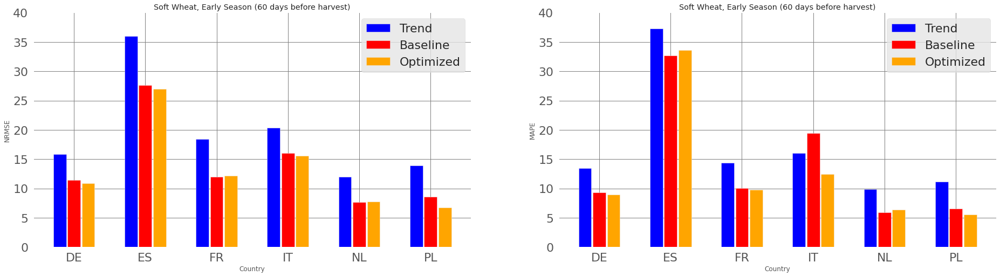

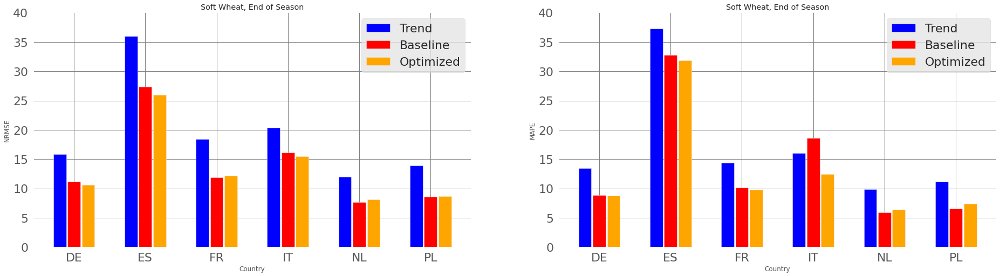

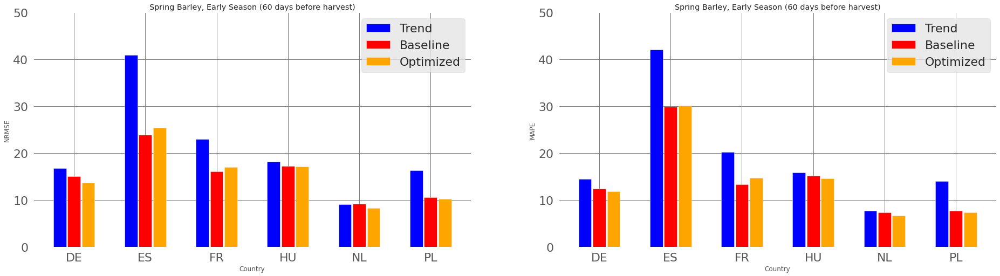

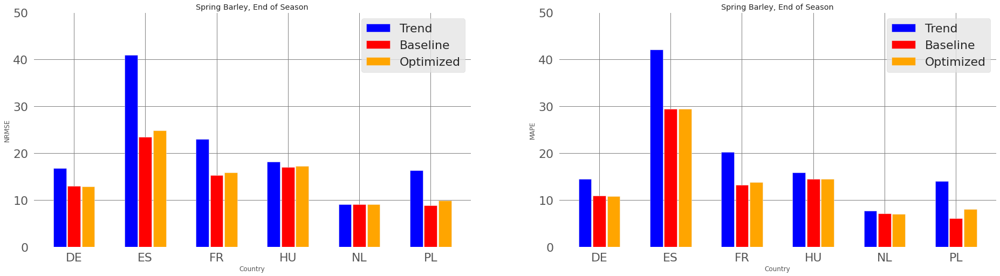

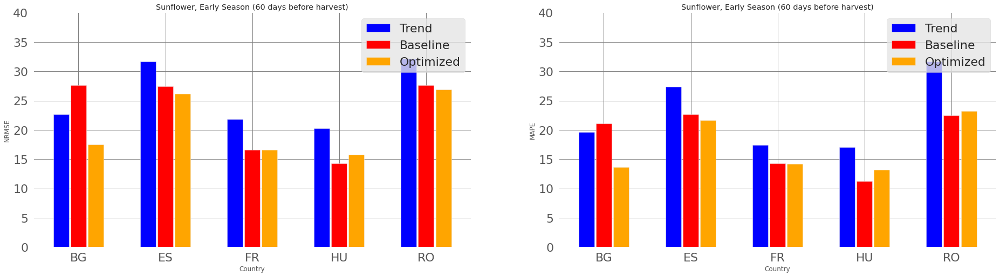

...

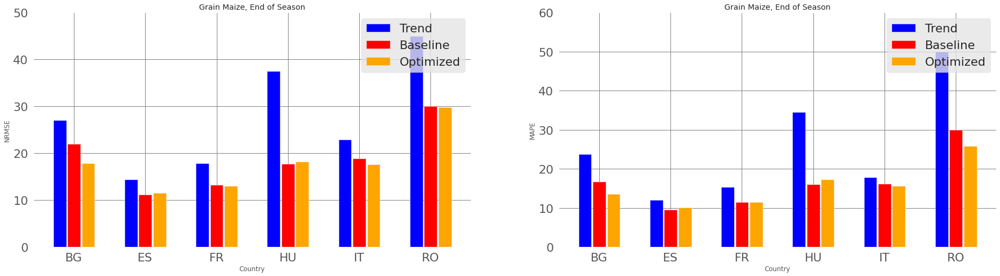

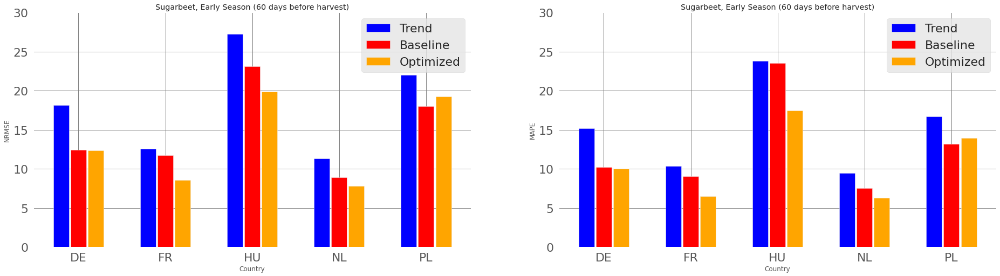

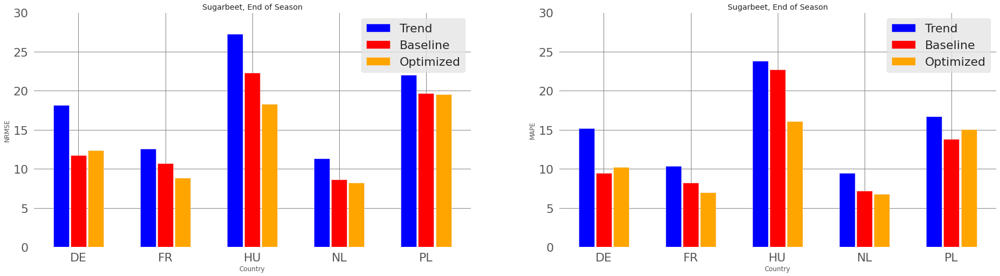

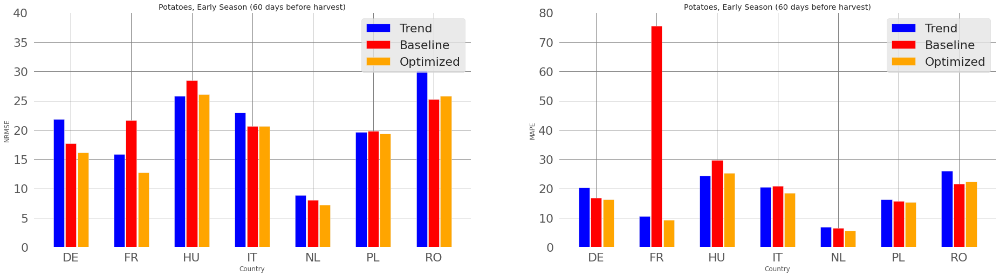

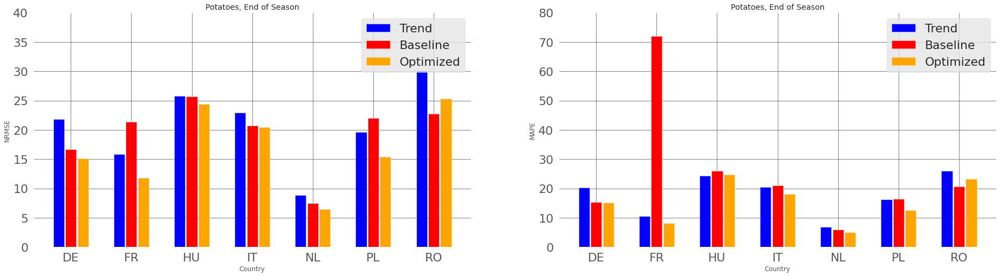

In [ ]:
%matplotlib inline
plt.style.use('ggplot')

crops = mlb_early6_sum_df['CROP'].unique()
metrics_names = ['NRMSE', 'MAPE']
bar_labels = ['Trend', 'Baseline', 'Optimized']

for cr in crops:
  # Early Season
  sel_mlb_early6_df = mlb_early6_sum_df[mlb_early6_sum_df['CROP'] == cr]
  sel_opt_early6_df = opt_early6_sum_df[opt_early6_sum_df['CROP'] == cr]
  crop_countries = sel_mlb_early6_df['COUNTRY'].unique()
  early_title = cr.title() + ', Early Season (60 days before harvest)'
  plotRegionalSummaryMetrics(crop_countries, metrics_names, sel_mlb_early6_df, sel_opt_early6_df,
                             early_title, bar_labels)

  # End of Season
  sel_mlb_end_df = mlb_end_sum_df[mlb_end_sum_df['CROP'] == cr]
  sel_opt_end_df = opt_end_sum_df[opt_end_sum_df['CROP'] == cr]
  crop_countries = sel_mlb_end_df['COUNTRY'].unique()
  end_title = cr.title() + ', End of Season'
  plotRegionalSummaryMetrics(crop_countries, metrics_names, sel_mlb_end_df, sel_opt_end_df,
                             end_title, bar_labels)

### Comparison Graphs on a map

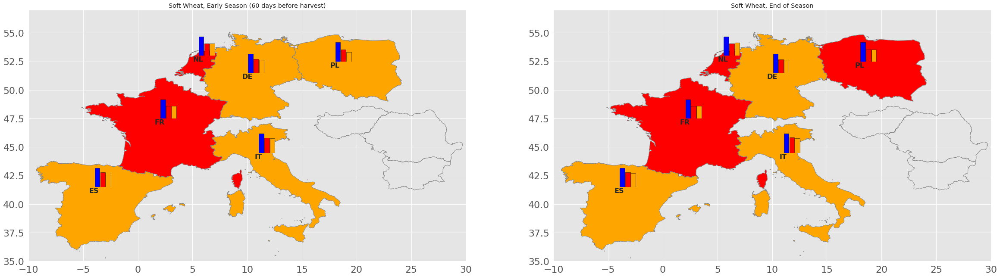

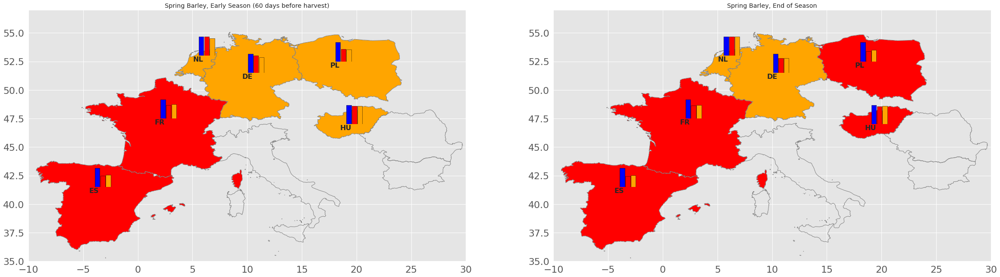

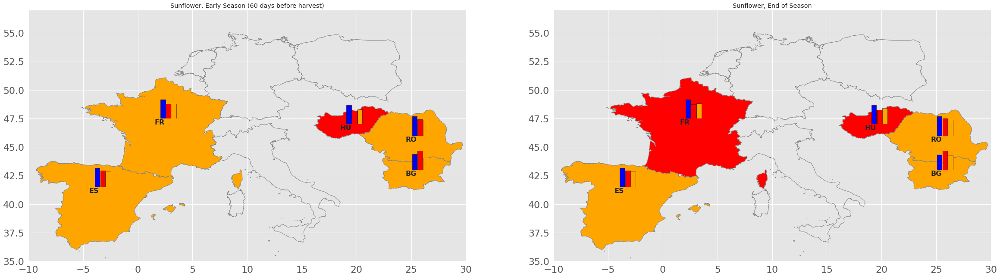

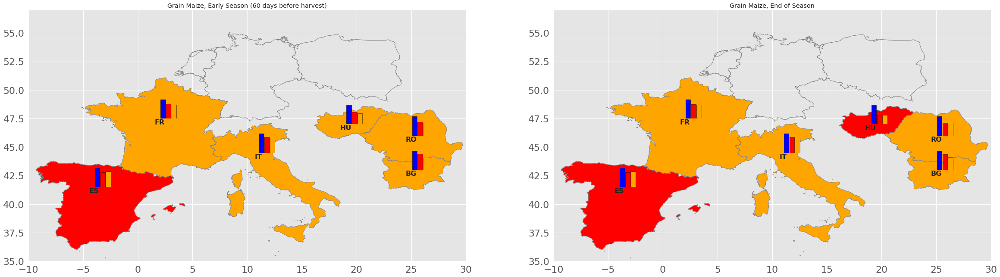

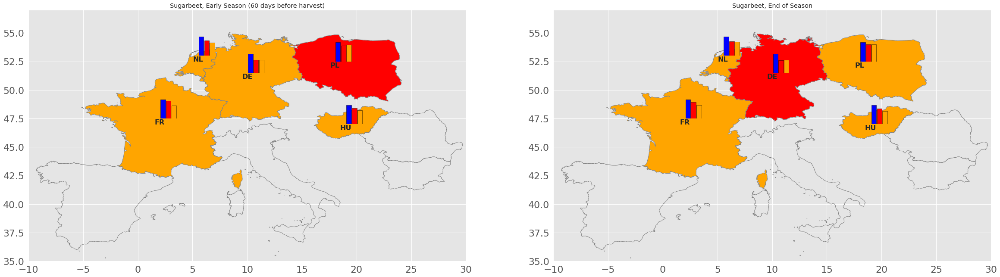

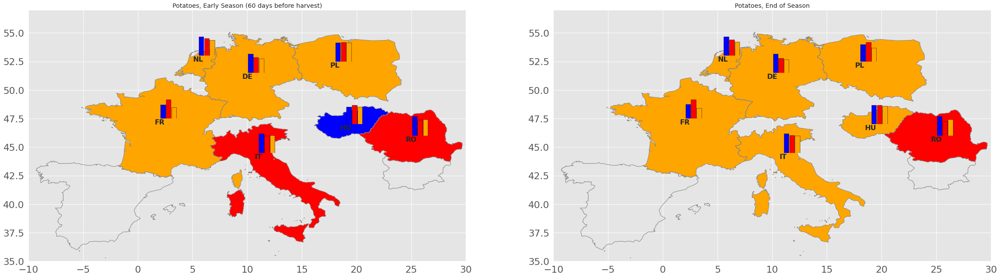

In [ ]:
%matplotlib inline
plt.style.use('ggplot')

crops = mlb_early6_sum_df['CROP'].unique()
metrics_names = ['NRMSE', 'MAPE']
bar_labels = ['Trend', 'Baseline', 'Optimized']

for cr in crops:
  sel_mlb_early6_df = mlb_early6_sum_df[mlb_early6_sum_df['CROP'] == cr]
  sel_opt_early6_df = opt_early6_sum_df[opt_early6_sum_df['CROP'] == cr]
  sel_mlb_end_df = mlb_end_sum_df[mlb_end_sum_df['CROP'] == cr]
  sel_opt_end_df = opt_end_sum_df[opt_end_sum_df['CROP'] == cr]
  crop_countries = sel_mlb_early6_df['COUNTRY'].unique()

  early_title = cr.title() + ', Early Season (60 days before harvest)'
  end_title = cr.title() + ', End of Season'
  plotRegionalMetricsOnMap(crop_countries, metrics_names, geo_pd_nuts0_df,
                           map_limits, country_xy,
                           [sel_mlb_early6_df, sel_mlb_end_df],
                           [sel_opt_early6_df, sel_opt_end_df],
                           [early_title, end_title], bar_labels)

### Predicted vs observed

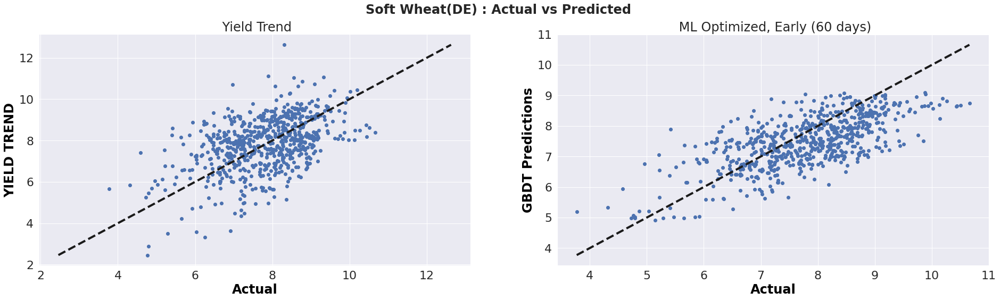

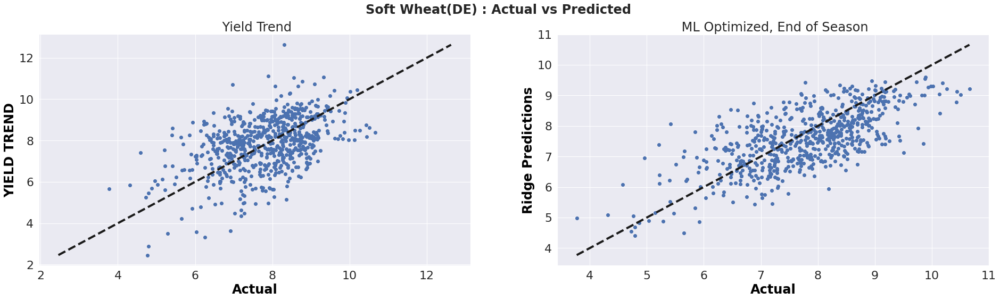

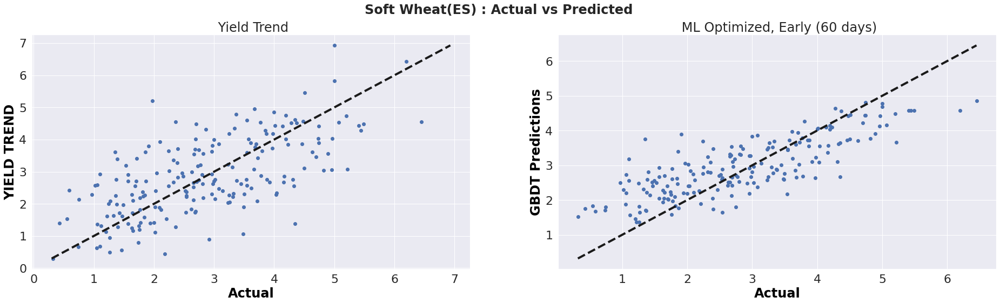

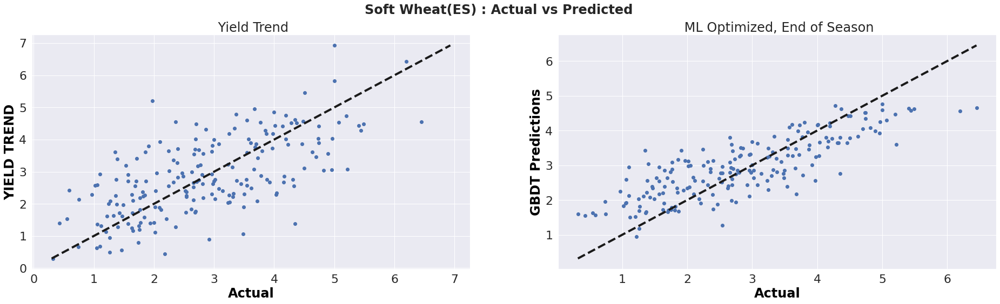

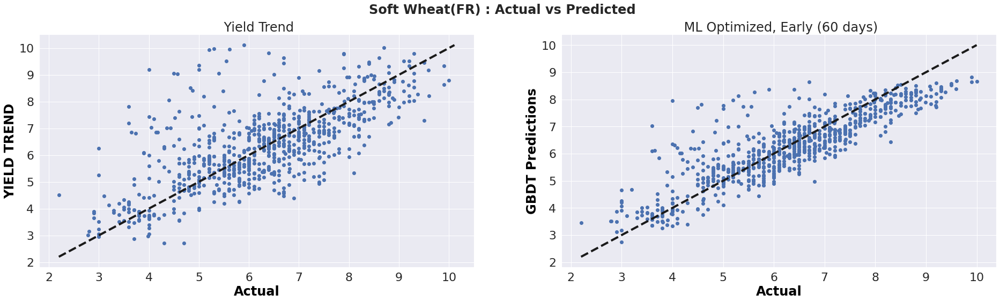

...

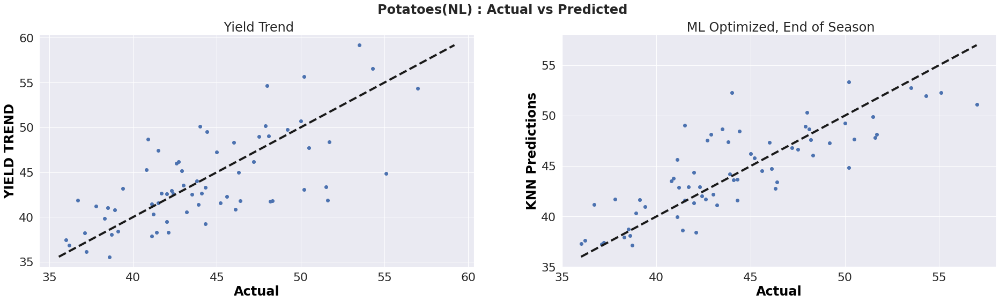

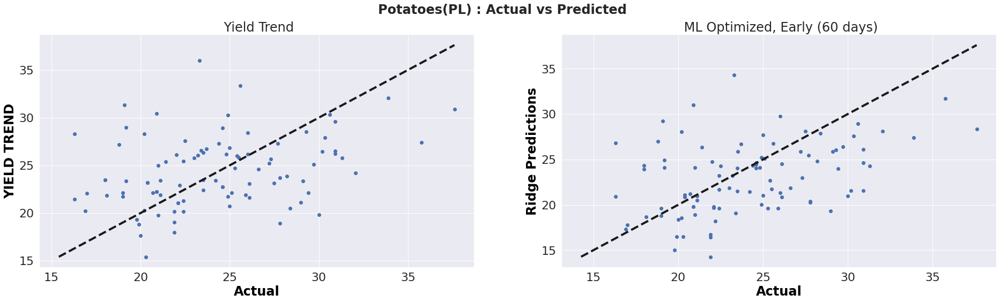

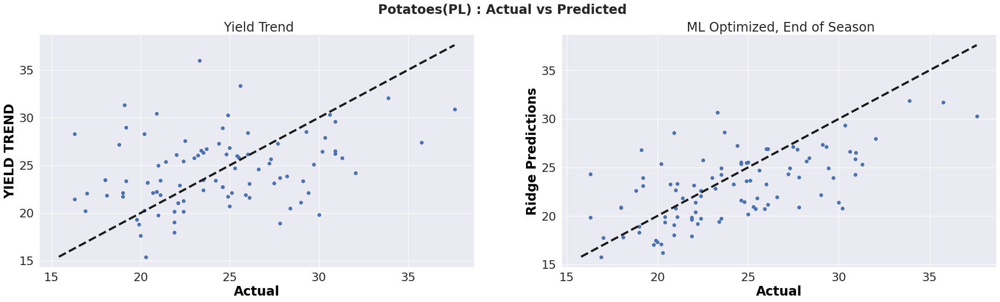

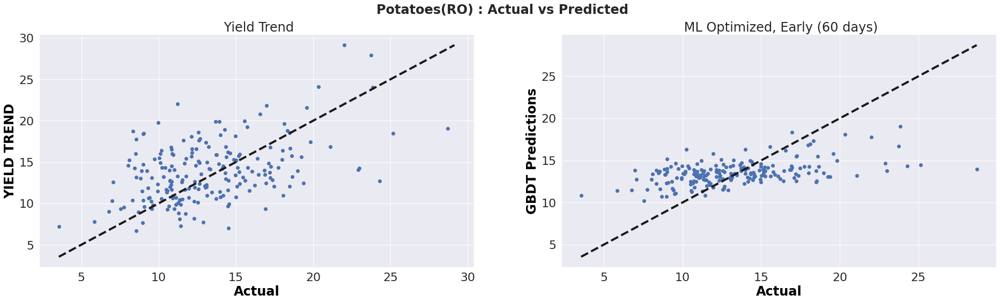

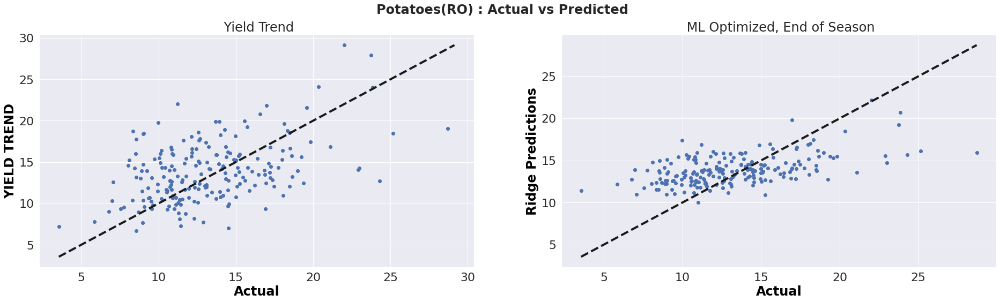

In [ ]:
crops = mlb_early6_sum_df['CROP'].unique()
# summary_dfs_early = [mlb_early6_sum_df, opt_early6_sum_df]
# summary_dfs_end = [mlb_end_sum_df, opt_end_sum_df]
summary_dfs_early = [opt_early6_sum_df]
summary_dfs_end = [opt_end_sum_df]

for cr in crops:
  crop_mlb_early6_df = mlb_early6_dfs[cr]
  crop_opt_early6_df = opt_early6_dfs[cr]
  crop_mlb_end_df = mlb_end_dfs[cr]
  crop_opt_end_df = opt_end_dfs[cr]

  crop_countries = crop_opt_early6_df['COUNTRY'].unique()
  for cn in crop_countries:
    mlb_cn_early6_df = crop_mlb_early6_df[crop_mlb_early6_df['COUNTRY'] == cn]
    opt_cn_early6_df = crop_opt_early6_df[crop_opt_early6_df['COUNTRY'] == cn]
    title_labels_early = [ '\n Yield Trend',
                         #  '\n ML Baseline, Early (60 days)',
                           '\n ML Optimized, Early (60 days)',
                         ]

    sel_ml_algs = getSelectedMLAlgorithmMulti(cr, cn, summary_dfs_early,
                                              debug_level, title_labels_early)
    # pred_dfs_early = [mlb_cn_early6_df, opt_cn_early6_df]
    pred_dfs_early = [opt_cn_early6_df]
    plotRegionalReportedVSPredicted(cr, cn, pred_dfs_early, sel_ml_algs, title_labels_early)

    mlb_cn_end_df = crop_mlb_end_df[crop_mlb_end_df['COUNTRY'] == cn]
    opt_cn_end_df = crop_opt_end_df[crop_opt_end_df['COUNTRY'] == cn]
    title_labels_end = [ '\n Yield Trend',
                       #  '\n ML Baseline, End of Season',
                         '\n ML Optimized, End of Season'
                       ]

    sel_ml_algs = getSelectedMLAlgorithmMulti(cr, cn, summary_dfs_end,
                                              debug_level, title_labels_end)
    # pred_dfs_end = [mlb_cn_end_df, opt_cn_end_df]
    pred_dfs_end = [opt_cn_end_df]
    plotRegionalReportedVSPredicted(cr, cn, pred_dfs_end, sel_ml_algs, title_labels_end)

### Residuals Box plots

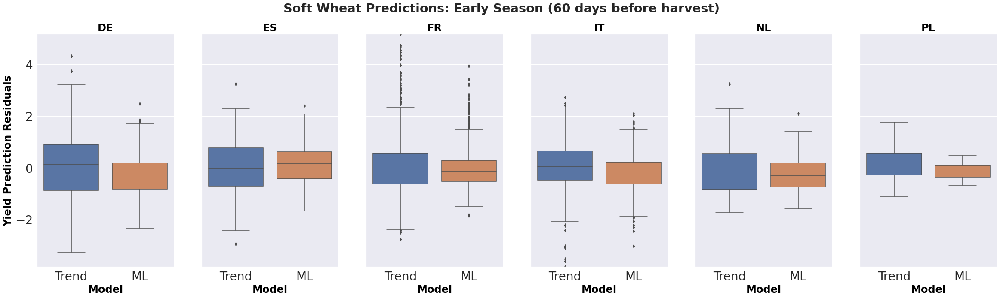

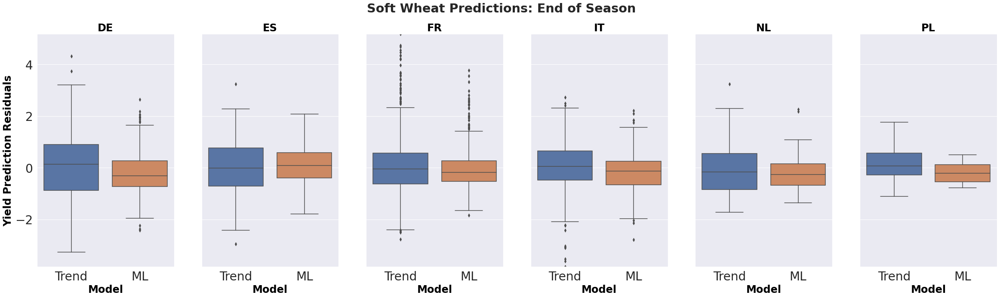

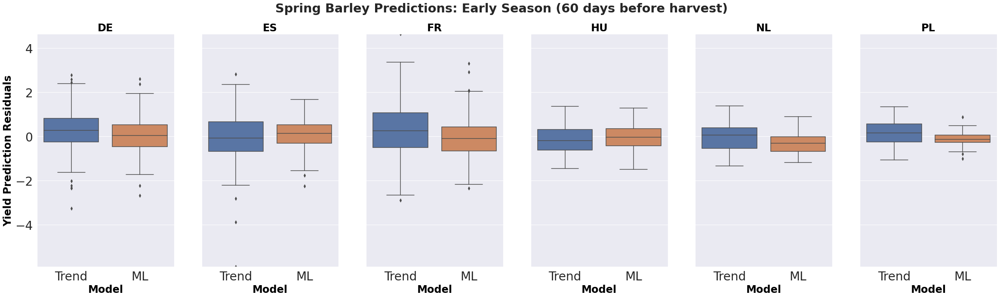

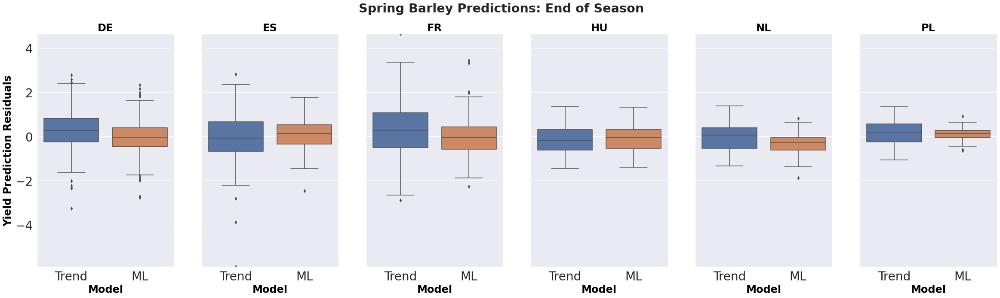

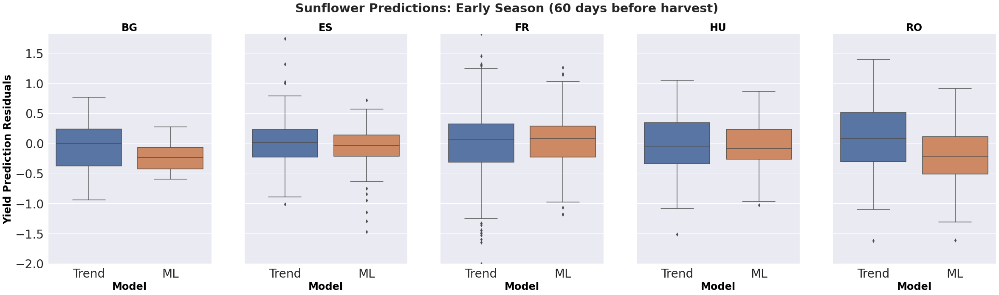

...

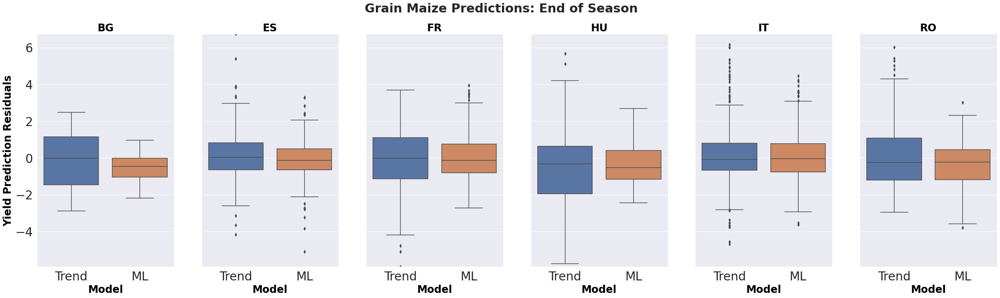

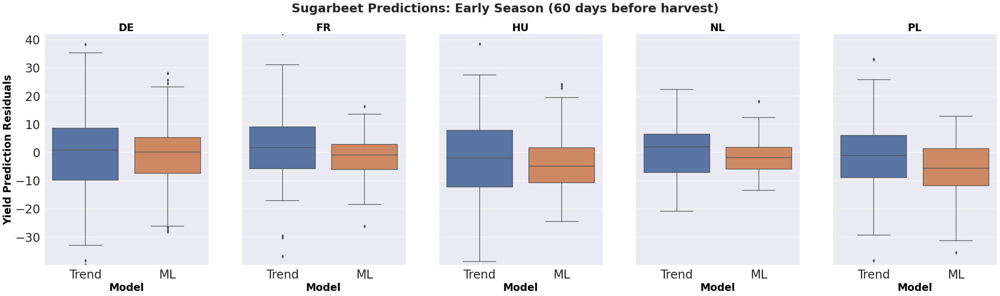

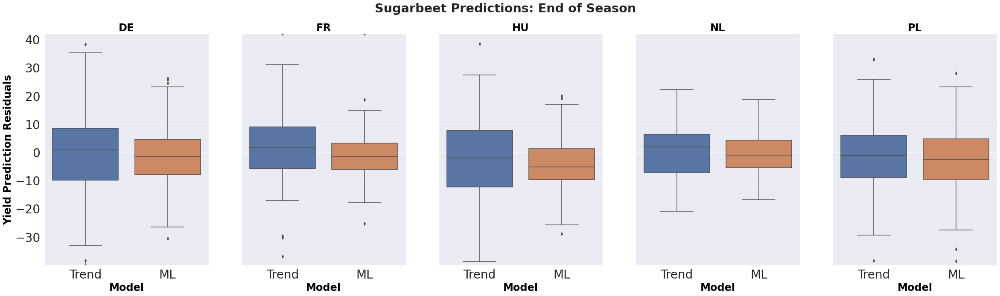

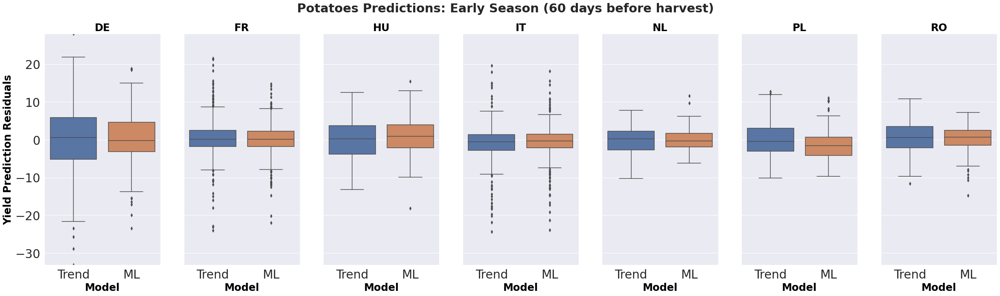

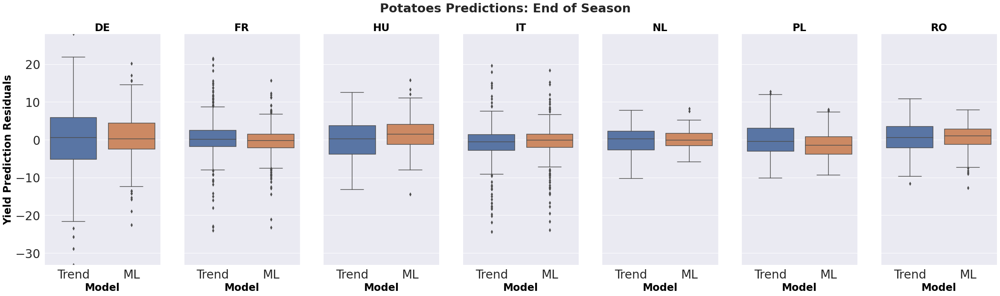

In [ ]:
crops = mlb_early6_sum_df['CROP'].unique()

for cr in crops:
  # crop_mlb_early6_df = mlb_early6_dfs[cr]
  crop_opt_early6_df = opt_early6_dfs[cr]
  # crop_mlb_end_df = mlb_end_dfs[cr]
  crop_opt_end_df = opt_end_dfs[cr]
  crop_countries = crop_opt_early6_df['COUNTRY'].unique()

  early6_title_label = 'Early Season (60 days before harvest)'
  # mlb_early6_ml_algs = {}
  opt_early6_ml_algs = {}
  for cn in crop_countries:
    # mlb_early6_ml_algs[cn] = getSelectedMLAlgorithm(cr, cn, mlb_early6_sum_df,
    #                                                 debug_level, early6_title_label)
    opt_early6_ml_algs[cn] = getSelectedMLAlgorithm(cr, cn, opt_early6_sum_df,
                                                    debug_level, early6_title_label)

  regionalResidualsBoxPlots(cr, crop_countries, crop_opt_early6_df, opt_early6_ml_algs,
                            early6_title_label)

  end_title_label = 'End of Season'
  # mlb_end_ml_algs = {}
  opt_end_ml_algs = {}
  for cn in crop_countries:
    # mlb_end_ml_algs[cn] = getSelectedMLAlgorithm(cr, cn, mlb_end_sum_df,
    #                                              debug_level, end_title_label)
    opt_end_ml_algs[cn] = getSelectedMLAlgorithm(cr, cn, opt_end_sum_df,
                                                 debug_level, end_title_label)

  regionalResidualsBoxPlots(cr, crop_countries, crop_opt_end_df, opt_end_ml_algs,
                            end_title_label)

## Plot NUTS level maps

### Load and filter data

In [ ]:
from sklearn.metrics import mean_squared_error
from sklearn.metrics import mean_absolute_error
from sklearn.metrics import r2_score

crop = 'soft wheat'
debug_level = 2
country_nuts = {
    'BG' : 'NUTS2',
    'DE' : 'NUTS3',
    'ES' : 'NUTS3',
    'FR' : 'NUTS3',
    'HU' : 'NUTS3',
    'IT' : 'NUTS3',
    'NL' : 'NUTS2',
    'PL' : 'NUTS2',
    'RO' : 'NUTS3',
}

metrics_functions = {
    # MAE (y_true, y_obs) = ( 1 / n ) * sum_i-n ( | y_true_i - y_obs_i | )
    # 'MAE' : mean_absolute_error,
    # MAPE (y_true, y_obs) = ( 1 / n ) * sum_i-n ( ( y_true_i - y_obs_i ) / y_true_i )
    'MAPE' : meanAbsolutePercentageError,
    # MSE (y_true, y_obs) = ( 1 / n ) * sum_i-n ( y_true_i - y_obs_i )^2
    'RMSE' : mean_squared_error,
    # R2 (y_true, y_obs) = 1 - ( ( sum_i-n ( y_true_i - y_obs_i )^2 )
    #                           / sum_i-n ( y_true_i - mean(y_true) )^2)
    'R2' : r2_score,
}

# Same order as above
metrics_names = ['MAPE', 'NRMSE', 'R2']
ml_algorithms = ['Ridge', 'KNN', 'SVR', 'GBDT']
summary_columns = ['CROP', 'COUNTRY', 'ALGORITHM'] + metrics_names

pd_preds_all_df = None
sel_ml_algs = {}
predictions_dir = 'optimized'
early_season = True
early_season_end = -6

countries_nuts0 = list(country_nuts.keys())
geo_pd_nuts0_df = getNUTSGeoPandasData(countries_nuts0, 'NUTS0')

countries_nuts2 = ['BG', 'NL', 'PL']
countries_nuts3 = ['DE', 'ES', 'FR', 'HU', 'IT', 'RO']
geo_pd_all_df = getNUTSGeoPandasData(countries_nuts2, 'NUTS2')
geo_pd_all_df = geo_pd_all_df.append(getNUTSGeoPandasData(countries_nuts3, 'NUTS3'))
geo_pd_all_df['COUNTRY'] = geo_pd_all_df['NUTS_ID'].str[:2]

map_limits = {
    'xmin' : -10, 'xmax' : 30,
    'ymin' : 35, 'ymax' : 60,
}

country_xy = {
    'BG' : [25.0, 42.5],
    'DE' : [10.0, 51.0],
    'ES' : [-4.0, 41.0],
    'FR' : [2.0, 47.0],
    'HU' : [19.0, 46.5],
    'IT' : [11.0, 44.0],
    'NL' : [5.5, 52.5],
    'PL' : [18.0, 52.0],
    'RO' : [25.0, 45.5],
}

for cn in country_nuts:
  nuts_level = country_nuts[cn]
  pd_preds_df = getMLPredictionsCropCountry(predictions_dir, crop, cn, nuts_level,
                                            early_season=early_season,
                                            early_season_end=early_season_end,
                                            debug_level=debug_level)
  if (pd_preds_df is None):
    continue

  pd_preds_df, ml_alg = selectMinRMSEMLAlgorithm(crop, cn, nuts_level,
                                                 pd_preds_df, ml_algorithms,
                                                 metrics_functions, summary_columns)
  sel_ml_algs[cn] = ml_alg
  if (pd_preds_all_df is None):
    pd_preds_all_df = pd_preds_df
  else:
    pd_preds_all_df = pd_preds_all_df.append(pd_preds_df)

print(geo_pd_all_df.head(5))
print(pd_preds_all_df.head(5))

fig_title = crop.title() + ' ('
countries = pd_preds_all_df['COUNTRY'].unique()
for cn in countries:
  fig_title += cn + ', '

fig_title = fig_title[:-2] + ')'

   NUTS_ID COUNTRY       NAME_LATN       NUTS_NAME  MOUNT_TYPE  URBN_TYPE  \
67    NL11      NL       Groningen       Groningen           0          0   
68    NL12      NL  Friesland (NL)  Friesland (NL)           0          0   
69    NL13      NL         Drenthe         Drenthe           0          0   
70    NL21      NL      Overijssel      Overijssel           0          0   
85    NL22      NL      Gelderland      Gelderland           0          0   

    COAST_TYPE                                           geometry  
67           0  MULTIPOLYGON (((6.87491 53.40801, 6.90124 53.3...  
68           0  MULTIPOLYGON (((6.31524 53.09405, 6.31004 53.0...  
69           0  POLYGON ((6.81381 53.07105, 6.93570 52.99336, ...  
70           0  POLYGON ((6.62943 52.66966, 6.70184 52.64941, ...  
85           0  POLYGON ((6.10979 52.44057, 6.11676 52.43150, ...  
  NUTS_ID  FYEAR  YIELD_TREND  YIELD_PRED  YIELD  TREND_RES   PRED_RES COUNTRY
0   DE118   2013         6.51    7.564138   8.24 -

### Average Yield Residual for Test Years

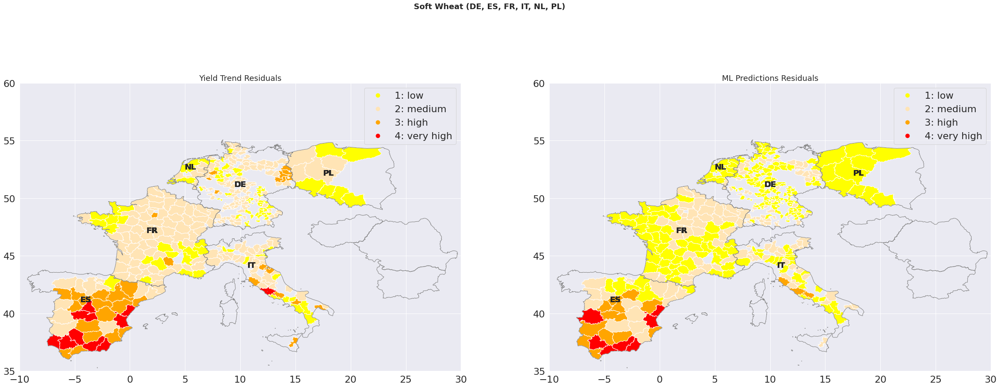

In [ ]:
plotRegionalAvgYieldResiduals(pd_preds_all_df, geo_pd_all_df,
                              map_limits, country_xy, fig_title)

# crop area threshold : How to decide which regions to keep? Ask JRC.
# Productions not area? YIELD * AREA = production
# Area, Production, 100 * Crop Area/Total Area (from shapefile)
# Threshold? Rank them and decide.

# What is the highest residual error that is acceptable? Ask JRC.
# National, NUTS2, NUTS3

# How do we define the error? Should be relative to the baseline.
# Subtract the ML residual percentage - Yield Trend residual percentage? See the difference.

### Yield Trend Residual Average and Variance

In [ ]:
pd_grouped1 = pd_preds_all_df.groupby(['COUNTRY', 'FYEAR']).agg(TREND_RES_AVG=('TREND_RES', 'mean'),
                                                                TREND_RES_STD=('TREND_RES', 'std')).reset_index()

pd_grouped2 = pd_preds_all_df.groupby(['COUNTRY', 'FYEAR']).agg(PRED_RES_AVG=('PRED_RES', 'mean'),
                                                                PRED_RES_STD=('PRED_RES', 'std')).reset_index()

pd_preds_stats = pd_grouped1.merge(pd_grouped2, on=['COUNTRY', 'FYEAR'])
pd_preds_stats['TREND_CV'] = pd_preds_stats['TREND_RES_STD']/pd_preds_stats['TREND_RES_AVG'].abs()
pd_preds_stats['PRED_CV'] = pd_preds_stats['PRED_RES_STD']/pd_preds_stats['PRED_RES_AVG'].abs()

sel_filter = (pd_preds_stats['TREND_RES_AVG'].abs() <= 10.0) & (pd_preds_stats['TREND_RES_STD'] >= 25.0)
print(pd_preds_stats[sel_filter].head(5).to_string(index=False))

# Crop, country, year            Cases where trend residual avg is low, variance is high
#                           TREND_RES_AVG  TREND_RES_STD  PRED_RES_AVG  PRED_RES_STD   TREND_CV   PRED_CV
# Soft wheat (ES 2015)           0.236057      28.928915     11.187514     26.956313  122.550762   2.4095
# Spring barley (ES 2015)       -0.34733       28.640297      7.286563     21.800898  82.458471    2.991932
# Sunflower (ES 2011)           -3.266558      31.170395     -5.623757     25.566125   9.542275    4.546093
# Sunflower (ES 2015)            7.972034      27.377420      1.785041     17.036495   3.434182    9.544033
# Grain maize (ES 2012)          0.984628      28.055036      3.459637     15.557371  28.493042    4.496822
# Grain maize (IT 2009)          5.051488      28.540378      7.758531     25.482972   5.649895    3.284510
# Sugar beets (HU 2010)         -2.230571       31.43884      7.9713       33.950619  14.094524    4.259107
# Potatoes (DE 2016)             5.009137      69.807635     19.205205    115.706645  13.936059    6.024754
# Potatoes (IT 2012)             7.751403      35.594794     15.270289     65.409644   4.592045    4.283458
# Potatoes (IT 2013)             3.432402      77.845765     15.314785     81.284367  22.679675    5.307575
# Potatoes (IT 2014)            -6.072762      62.799656      7.850147     40.863461  10.341201    5.205439

# from JRC
# Areas of concern showed different patterns. National forecasts not much different.
# Have a discussion with Marijn.

# MAPE at national level from Marijn's Paper:
# Country | Soft wheat | Spring barley | Sunflower | Grain maize | Sugar beets | Potatoes
# ----------------------------------------------------------------------------------------
# BG      |            |               |    10.85  |   11.95     |             |
# DE      |   3.99     |               |           |             |      4.41   | 2.54
# ES      |   5.03     |               |    10.03  |    2.54     |             |
# FR      |   3.11     |               |     6.32  |    4.01     |      3.73   | 3.56
# HU      |            |               |     5.78  |    4.97     |      3.31   | 5.97
# IT      |   3.91     |               |           |    6.21     |             | 3.68
# NL      |   6.11     |               |           |             |      4.05   | 3.26
# PL      |   5.17     |               |           |             |      5.74   | 6.88
# RO      |            |               |    16.59  |   10.21     |             | 6.96

# median across countries:
#          SW    GM      PO     SG      SF
# median	7.181	 7.9155	 6.309	6.8055	8.933

COUNTRY  FYEAR  TREND_RES_AVG  TREND_RES_STD  PRED_RES_AVG  PRED_RES_STD   TREND_CV  PRED_CV
     ES   2015       0.236057      28.928915     11.187514     26.956313 122.550762   2.4095


### Per Year Yield Residuals Interactive

In [ ]:
def warn(*args, **kwargs):
    pass

import warnings
warnings.warn = warn

test_years = sorted(pd_preds_all_df['FYEAR'].unique())
print('Yield Trend residuals')
plotInteractiveResidualsMap(pd_preds_all_df, test_years, geo_pd_all_df,
                            'TREND_RES', fig_title)

print('ML predictions residuals')
plotInteractiveResidualsMap(pd_preds_all_df, test_years, geo_pd_all_df,
                            'PRED_RES', fig_title)

### Per Year Yield Residuals Static

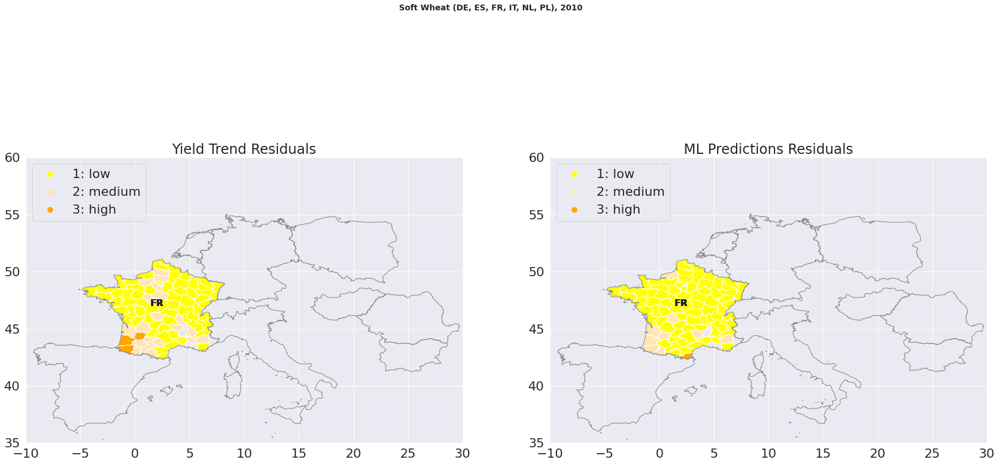

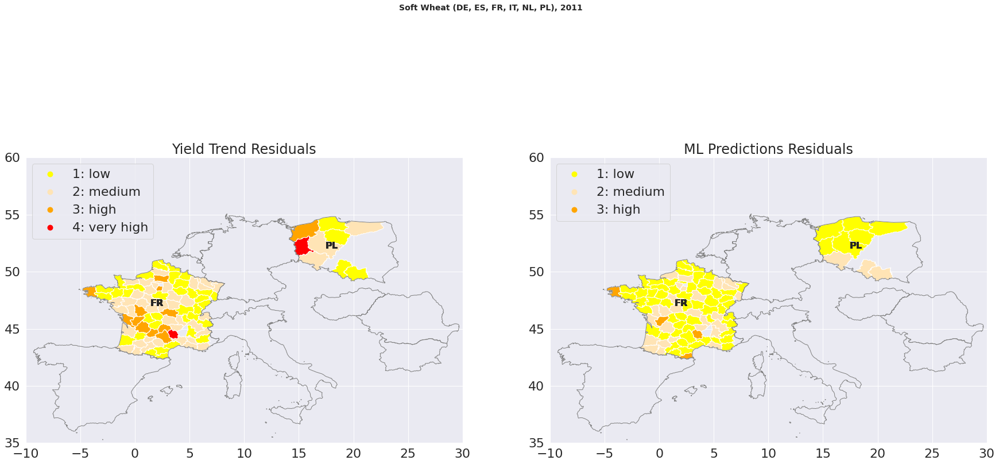

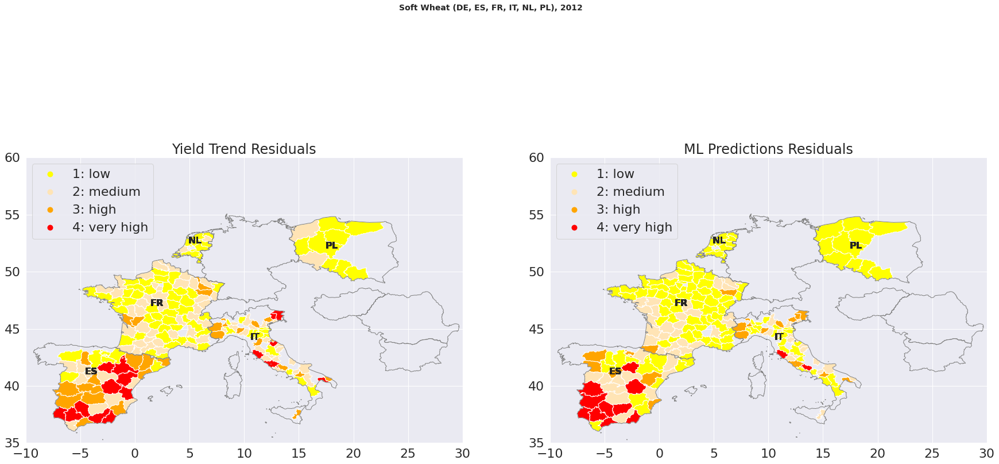

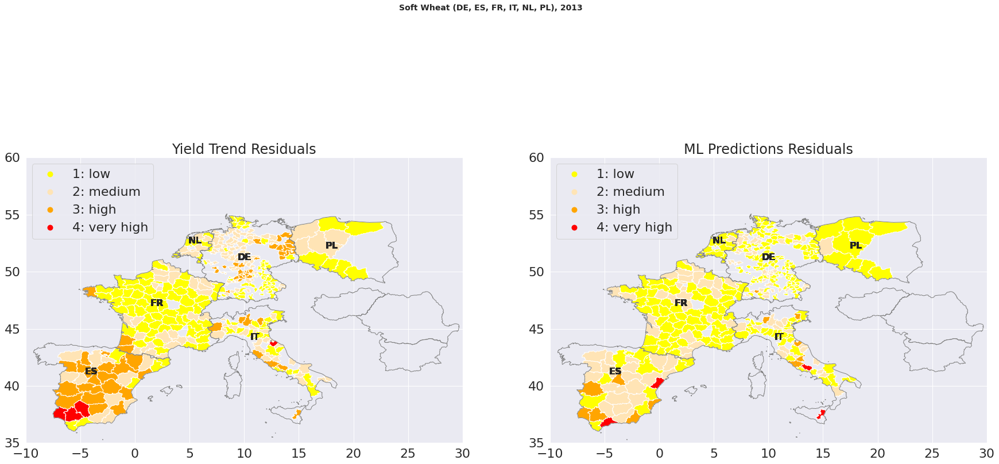

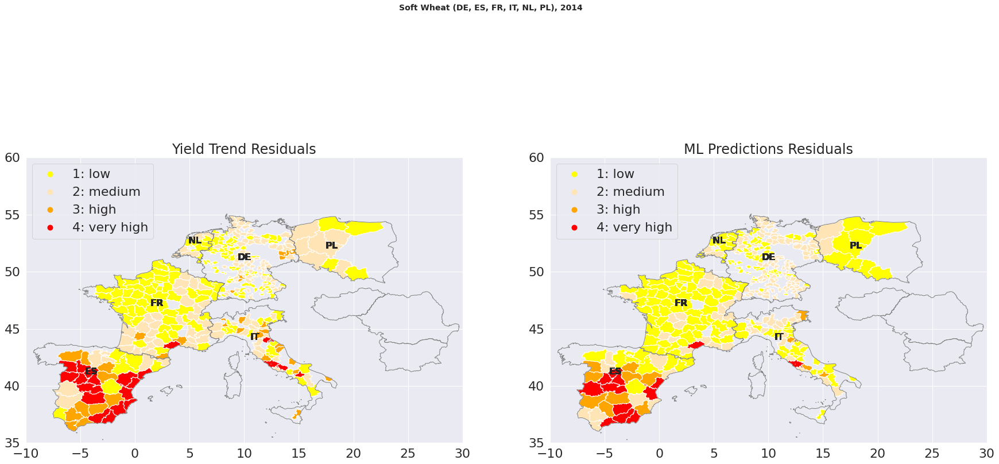

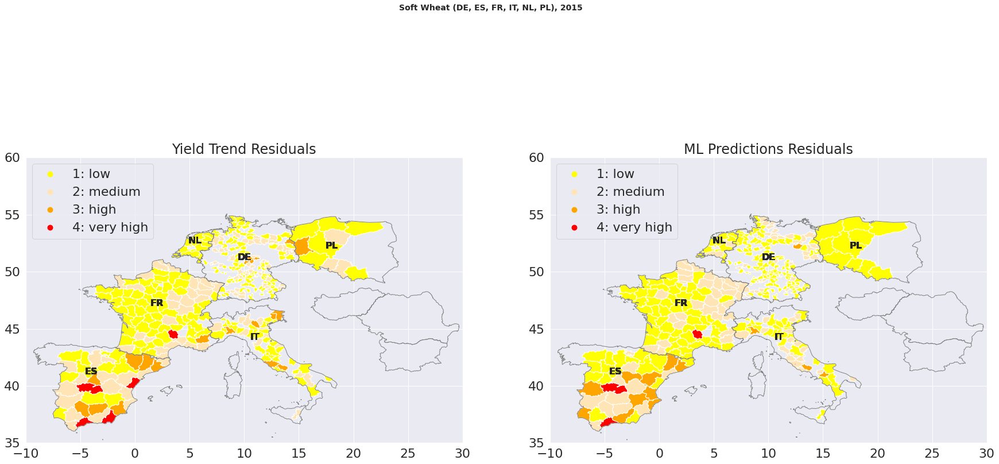

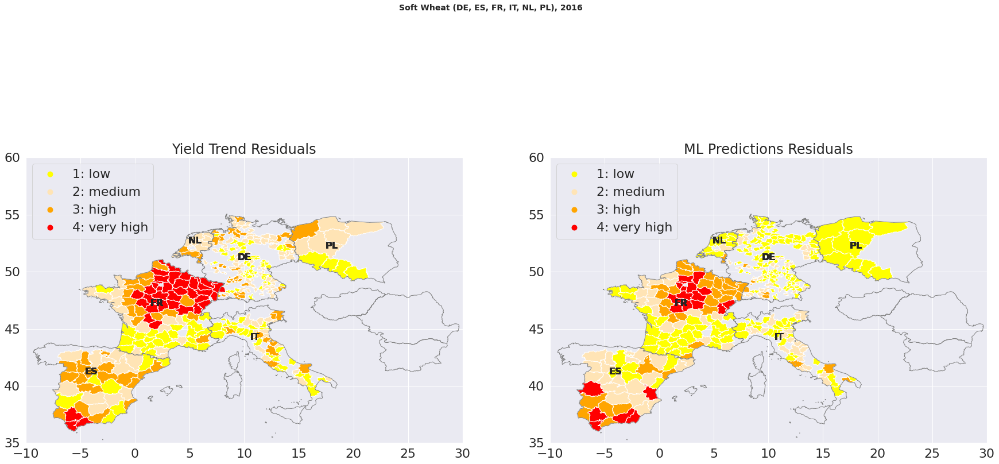

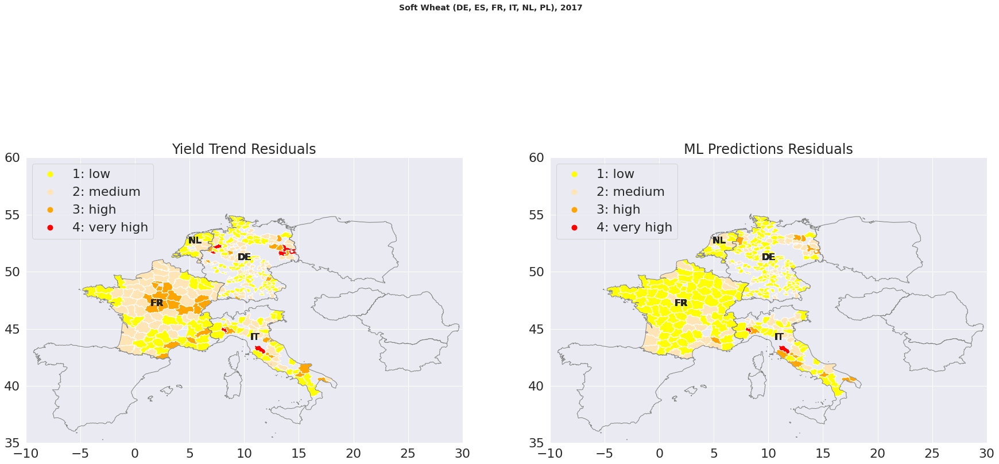

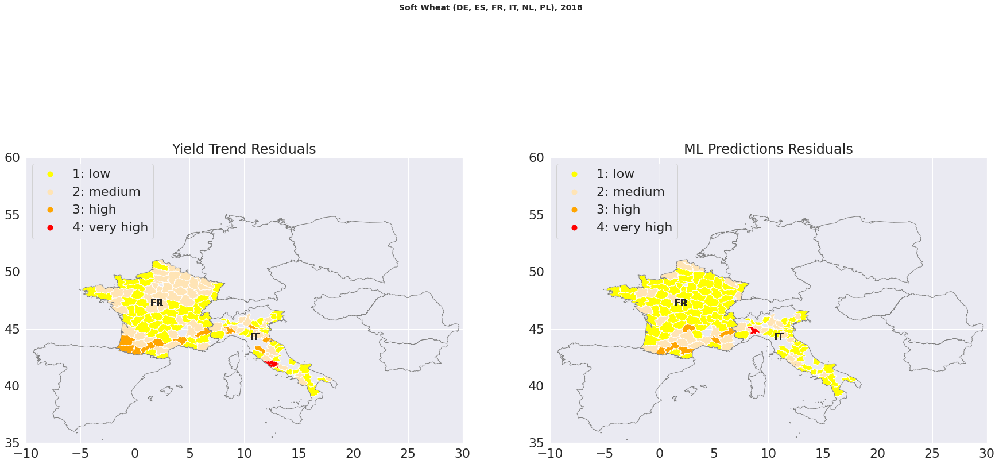

In [ ]:
test_years = sorted(pd_preds_all_df['FYEAR'].unique())
col_names = ['TREND_RES', 'PRED_RES']
col_labels = ['Yield Trend Residuals', 'ML Predictions Residuals']

plotStaticResidualsMaps(pd_preds_all_df, test_years,
                        geo_pd_nuts0_df, geo_pd_all_df,
                        map_limits, country_xy,
                        col_names, col_labels, fig_title)

### Predicted yield vs Observed Interactive

In [ ]:
def warn(*args, **kwargs):
    pass

import warnings
warnings.warn = warn

test_years = sorted(pd_preds_all_df['FYEAR'].unique())
show_cols = ['YIELD', 'YIELD_PRED']
crop_countries = sorted(pd_preds_all_df['COUNTRY'].unique())
country_conditions = [pd_preds_all_df['COUNTRY'] == cn for cn in crop_countries]
country_mins = []
country_maxs = []
country_ranges = []
for cn in crop_countries:
  cn_min = min([pd_preds_all_df[pd_preds_all_df['COUNTRY'] == cn][c].min() for c in show_cols])
  cn_max = max([pd_preds_all_df[pd_preds_all_df['COUNTRY'] == cn][c].max() for c in show_cols])
  country_mins.append(cn_min)
  country_maxs.append(cn_max)
  country_ranges.append(cn_max - cn_min)

pd_preds_all_df['CN_MIN'] = np.select(country_conditions, country_mins)
pd_preds_all_df['CN_MAX'] = np.select(country_conditions, country_maxs)
pd_preds_all_df['CN_RANGE'] = np.select(country_conditions, country_ranges)
for c in show_cols:
  pd_preds_all_df[c + '_SCALED'] = (pd_preds_all_df[c] - pd_preds_all_df['CN_MIN'])/pd_preds_all_df['CN_RANGE']

print('Yield Statistics')
plotInteractiveMap(pd_preds_all_df, test_years, geo_pd_all_df,
                   'YIELD', fig_title)

print('ML predictions')
plotInteractiveMap(pd_preds_all_df, test_years, geo_pd_all_df,
                   'YIELD_PRED', fig_title)

### Predicted vs Observed Static

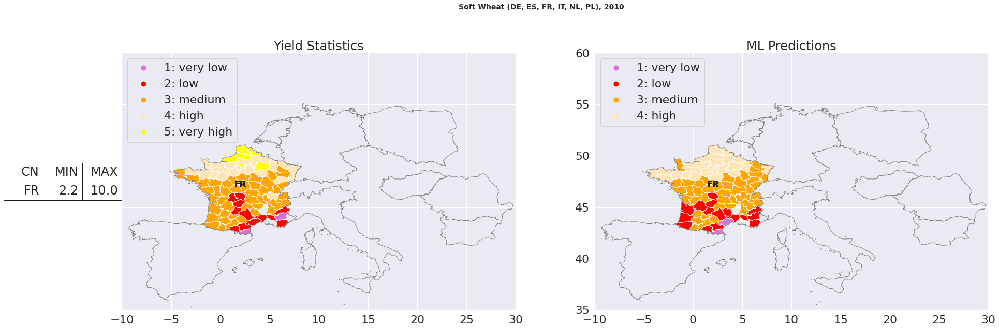

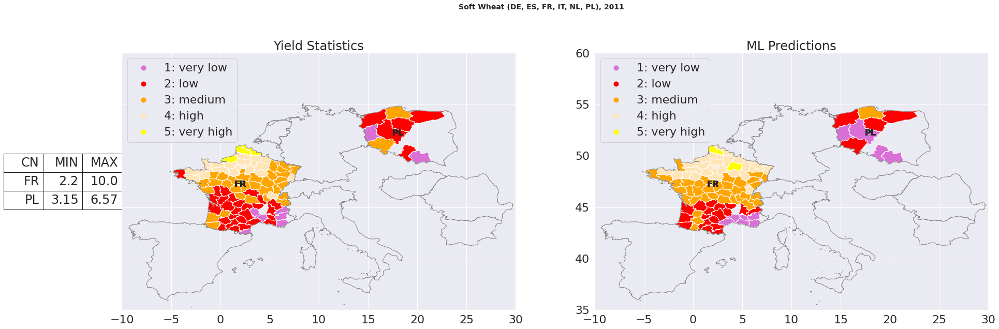

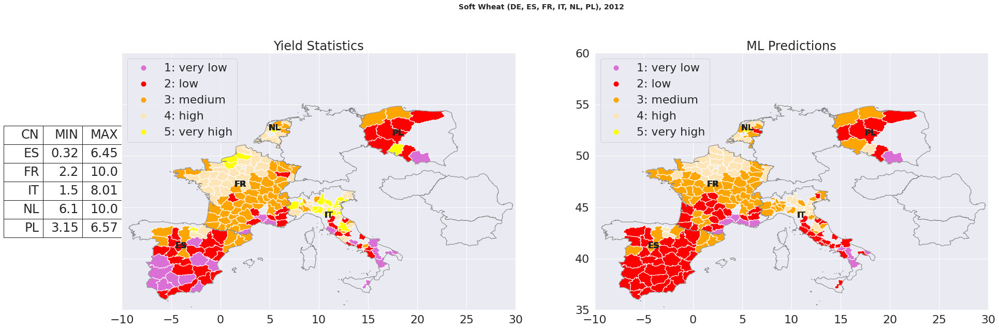

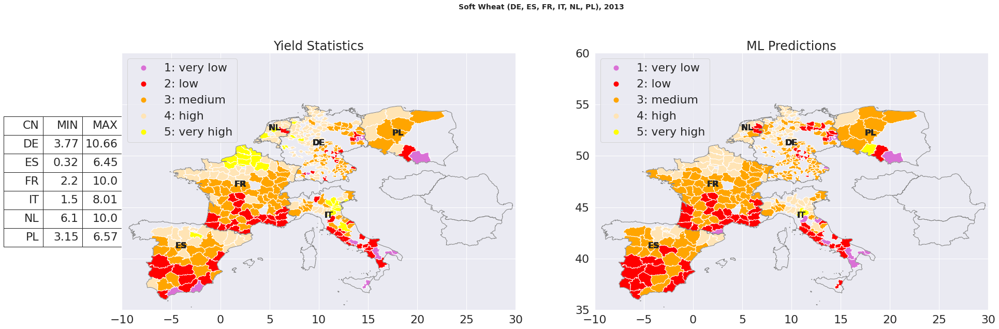

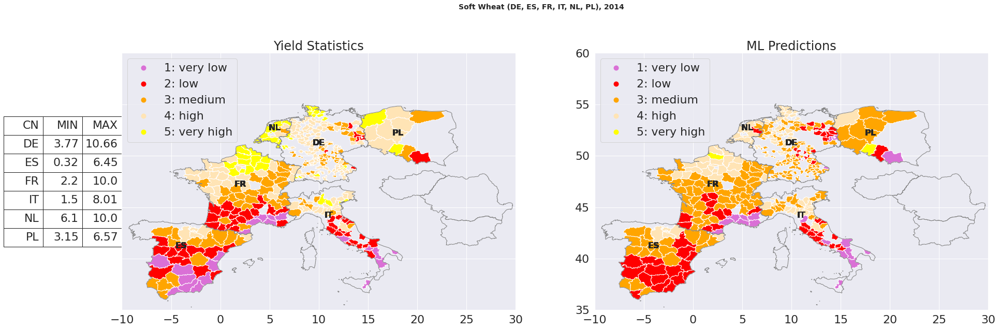

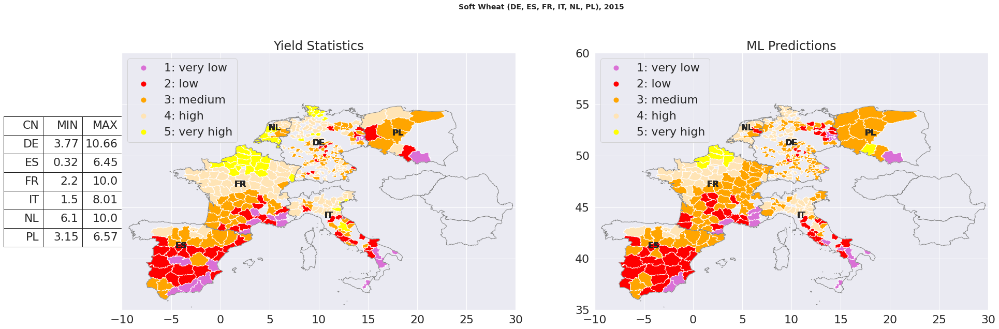

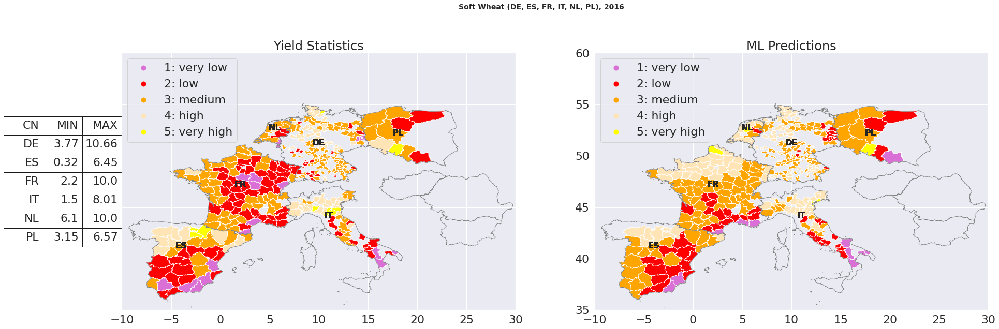

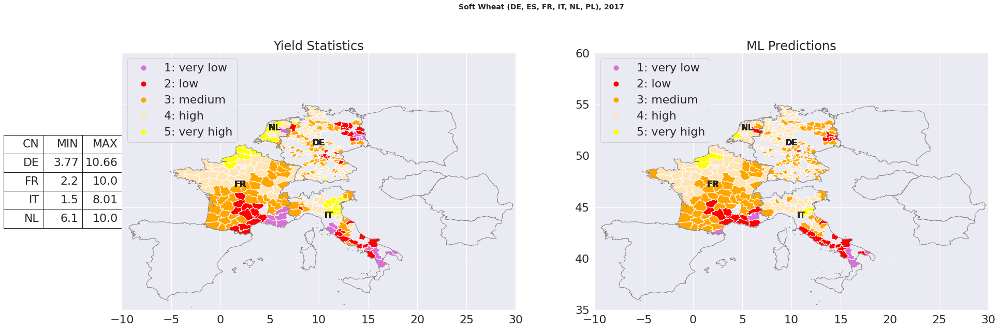

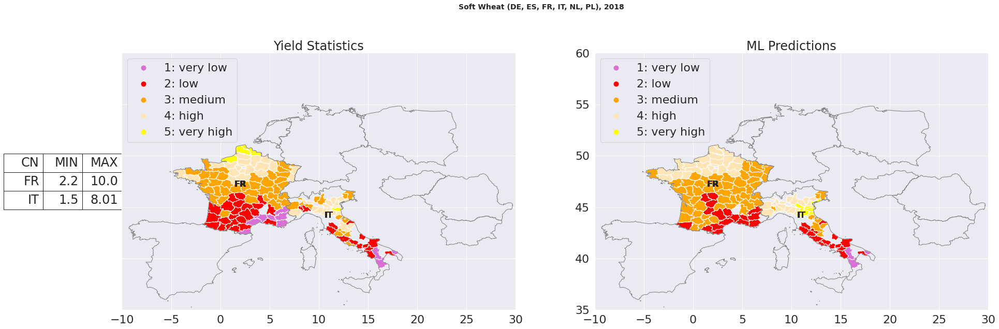

In [ ]:
test_years = sorted(pd_preds_all_df['FYEAR'].unique())
show_cols = ['YIELD', 'YIELD_PRED']
col_labels = ['Yield Statistics', 'ML Predictions']

if ('CN_RANGE' not in pd_preds_all_df.columns):
  crop_countries = sorted(pd_preds_all_df['COUNTRY'].unique())
  country_conditions = [pd_preds_all_df['COUNTRY'] == cn for cn in crop_countries]
  country_mins = []
  country_maxs = []
  country_ranges = []
  for cn in crop_countries:
    cn_min = min([pd_preds_all_df[pd_preds_all_df['COUNTRY'] == cn][c].min() for c in show_cols])
    cn_max = max([pd_preds_all_df[pd_preds_all_df['COUNTRY'] == cn][c].max() for c in show_cols])
    country_mins.append(cn_min)
    country_maxs.append(cn_max)
    country_ranges.append(cn_max - cn_min)

  pd_preds_all_df['CN_MIN'] = np.select(country_conditions, country_mins)
  pd_preds_all_df['CN_MAX'] = np.select(country_conditions, country_maxs)
  pd_preds_all_df['CN_RANGE'] = np.select(country_conditions, country_ranges)
  for c in show_cols:
    pd_preds_all_df[c + '_SCALED'] = (pd_preds_all_df[c] - pd_preds_all_df['CN_MIN'])/pd_preds_all_df['CN_RANGE']

plotStaticMaps(pd_preds_all_df, test_years, geo_pd_nuts0_df, geo_pd_all_df,
               map_limits, country_xy, show_cols, col_labels, fig_title)

### Confusion matrix for predicted and observed


In [ ]:
# NOTE run after saving specific year prediction classes
sel_year = 2016
pd_pred_yr_df = pd_preds_all_df[pd_preds_all_df['FYEAR'] == sel_year]

col_names = ['YIELD', 'YIELD_PRED']
sel_cols = ['NUTS_ID', 'COUNTRY'] + col_names
pred_classes = ['1: very low', '2: low', '3: medium', '4: high', '5: very high']
for i in range(len(col_names)):
  class_conditions = [ (pd_pred_yr_df[col_names[i] + '_SCALED'] <= 0.2),
                       (pd_pred_yr_df[col_names[i] + '_SCALED'] > 0.2) &
                       (pd_pred_yr_df[col_names[i] + '_SCALED'] <= 0.4),
                       (pd_pred_yr_df[col_names[i] + '_SCALED'] > 0.4) &
                       (pd_pred_yr_df[col_names[i] + '_SCALED'] <= 0.6),
                       (pd_pred_yr_df[col_names[i] + '_SCALED'] > 0.6) &
                       (pd_pred_yr_df[col_names[i] + '_SCALED'] <= 0.8),
                       (pd_pred_yr_df[col_names[i] + '_SCALED'] > 0.8),
                     ]

  yield_class_col = col_names[i] + '_CLASS'
  sel_cols.append(yield_class_col)
  pd_pred_yr_df[yield_class_col] = np.select(class_conditions, pred_classes)

pd_pred_yr_df = pd_pred_yr_df[sel_cols]
pd_pred_yr_df.to_csv( crop.replace(' ', '_') + str(sel_year) + '.csv')

print('total', pd_pred_yr_df['NUTS_ID'].count())
pd_pred_yr_df['YIELD_CLASS'] = pd_pred_yr_df['YIELD_CLASS'].str[:1]
pd_pred_yr_df['YIELD_PRED_CLASS'] = pd_pred_yr_df['YIELD_PRED_CLASS'].str[:1]
pd_pred_yr_df['YIELD_CLASS'] = pd_pred_yr_df['YIELD_CLASS'].astype('int')
pd_pred_yr_df['YIELD_PRED_CLASS'] = pd_pred_yr_df['YIELD_PRED_CLASS'].astype('int')
print(pd_pred_yr_df.head(5))

print('\n')
print('####################')
print('# Confusion Matrix #')
print('####################')

confusion_dict = {}
for yc in [1, 2, 3, 4, 5]:
  pc_counts = [pd_pred_yr_df[(pd_pred_yr_df['YIELD_CLASS'] == yc) &
                             (pd_pred_yr_df['YIELD_PRED_CLASS'] == pc)]['NUTS_ID'].count() for pc in [1, 2, 3, 4, 5]]
  confusion_dict['row' + str(yc - 1)] = pc_counts

pd_conf_df = pd.DataFrame.from_dict(confusion_dict, orient='index',
                                    columns=['p1', 'p2', 'p3', 'p4', 'p5'])
print(pd_conf_df.head(5))

offby1_filter = ((pd_pred_yr_df['YIELD_CLASS'] - pd_pred_yr_df['YIELD_PRED_CLASS']).abs() == 1)
offby1_regions = pd_pred_yr_df[offby1_filter]['NUTS_ID'].unique()
print('\n')
print('######################')
print('# Regions off by 1   #')
print('######################')
print(offby1_regions)

print('\n')
print('##################################')
print('# Off by 1 regions by country    #')
print('##################################')
print(pd_pred_yr_df[offby1_filter].groupby(['COUNTRY'])['NUTS_ID'].count())

offby2_filter = ((pd_pred_yr_df['YIELD_CLASS'] - pd_pred_yr_df['YIELD_PRED_CLASS']).abs() == 2)
if (len(pd_pred_yr_df[offby2_filter]['NUTS_ID'].unique()) > 0):
  print('\n')
  print('######################')
  print('# Regions off by 2   #')
  print('######################')

  print(pd_pred_yr_df[offby2_filter]['NUTS_ID'].unique())
  print(pd_pred_yr_df[offby2_filter].groupby(['COUNTRY'])['NUTS_ID'].count())

print('\n')
print('###########################')
print('Regions off by > 2        #')
print('###########################')
offbygt2_filter = ((pd_pred_yr_df['YIELD_CLASS'] - pd_pred_yr_df['YIELD_PRED_CLASS']).abs() > 2)
if (len(pd_pred_yr_df[offbygt2_filter]['NUTS_ID'].unique()) > 0):
  print('\n')
  print('#################################')
  print('# Off by > 2 regions by country #')
  print('#################################')

  print(pd_pred_yr_df[offbygt2_filter]['NUTS_ID'].unique())
  print(pd_pred_yr_df[offbygt2_filter].groupby(['COUNTRY'])['NUTS_ID'].count())

total 325
   NUTS_ID COUNTRY  YIELD  YIELD_PRED  YIELD_CLASS  YIELD_PRED_CLASS
3    DE118      DE   7.11    7.682202            3                 3
8    DE119      DE   6.85    7.400431            3                 3
13   DE11B      DE   6.69    6.587445            3                 3
18   DE11D      DE   6.76    7.885039            3                 3
23   DE123      DE   5.85    7.329422            2                 3


####################
# Confusion Matrix #
####################
      p1  p2  p3  p4  p5
row0   6   5   4   2   0
row1   5  34  37  11   0
row2   0  12  91  43   1
row3   0   0  22  41   2
row4   0   0   0   8   1


######################
# Regions off by 1   #
######################
['DE123' 'DE127' 'DE128' 'DE132' 'DE134' 'DE136' 'DE141' 'DE143' 'DE145'
 'DE147' 'DE148' 'DE149' 'DE21B' 'DE21H' 'DE226' 'DE227' 'DE22B' 'DE22C'
 'DE238' 'DE24A' 'DE267' 'DE275' 'DE27B' 'DE27D' 'DE406' 'DE407' 'DE409'
 'DE40B' 'DE40G' 'DE71E' 'DE723' 'DE734' 'DE914' 'DE932' 'DE939' 'DE946

## Comparison with MCYFS predictions

### Load data and create summaries

In [ ]:
from sklearn.metrics import mean_squared_error
from sklearn.metrics import mean_absolute_error
from sklearn.metrics import r2_score

debug_level = 2

metrics_functions = {
    # MAE (y_true, y_obs) = ( 1 / n ) * sum_i-n ( | y_true_i - y_obs_i | )
    # 'MAE' : mean_absolute_error,
    # MAPE (y_true, y_obs) = ( 1 / n ) * sum_i-n ( ( y_true_i - y_obs_i ) / y_true_i )
    'MAPE' : meanAbsolutePercentageError,
    # MSE (y_true, y_obs) = ( 1 / n ) * sum_i-n ( y_true_i - y_obs_i )^2
    'RMSE' : mean_squared_error,
    # R2 (y_true, y_obs) = 1 - ( ( sum_i-n ( y_true_i - y_obs_i )^2 )
    #                           / sum_i-n ( y_true_i - mean(y_true) )^2)
    'R2' : r2_score,
}

# Same order as above
metrics_names = ['MAPE', 'NRMSE', 'R2']
ml_algorithms = ['Ridge', 'KNN', 'SVR', 'GBDT']
summary_columns = ['CROP', 'COUNTRY', 'ALGORITHM'] + metrics_names

baseline_dir = 'baseline'
optim_dir = 'optimized'

crops = ['soft wheat', 'spring barley', 'sunflower', 'grain maize', 'sugarbeet', 'potatoes']
countries = ['BG', 'DE', 'ES', 'FR', 'HU', 'IT', 'NL', 'PL', 'RO']

mlb_early6_dfs, opt_early6_dfs = readNUTS0Predictions(baseline_dir, optim_dir, crops, countries,
                                                      early_season=True, early_season_end=-6,
                                                      debug_level=debug_level)
mlb_end_dfs, opt_end_dfs = readNUTS0Predictions(baseline_dir, optim_dir, crops, countries,
                                                debug_level=debug_level)

order_cols = ['IDREGION', 'FYEAR']
mlb_early6_summary = {}
opt_early6_summary = {}
mlb_end_summary = {}
opt_end_summary = {}

for cr in crops:
  crop_mlb_early6_df = mlb_early6_dfs[cr]
  crop_opt_early6_df = opt_early6_dfs[cr]
  crop_mlb_end_df = mlb_end_dfs[cr]
  crop_opt_end_df = opt_end_dfs[cr]

  if (debug_level > 2):
      print(cr, ' predictions check:', (crop_mlb_early6_df is not None))

  if (crop_mlb_early6_df is None):
    continue

  crop_mlb_early6_df['COUNTRY'] = crop_mlb_early6_df['IDREGION'].str[:2]
  crop_opt_early6_df['COUNTRY'] = crop_opt_early6_df['IDREGION'].str[:2]
  crop_mlb_end_df['COUNTRY'] = crop_mlb_end_df['IDREGION'].str[:2]
  crop_opt_end_df['COUNTRY'] = crop_opt_end_df['IDREGION'].str[:2]
  for cn in countries:
    mlb_early6_df = crop_mlb_early6_df[crop_mlb_early6_df['COUNTRY'] == cn]
    if (debug_level > 2):
      print(cr, cn, ' predictions check:', (not mlb_early6_df.empty))

    if (mlb_early6_df.empty):
      continue

    opt_early6_df = crop_opt_early6_df[crop_opt_early6_df['COUNTRY'] == cn]
    mlb_early6_summary = getNUTS0PredictionSummary(mlb_early6_df, cr, cn, ml_algorithms, metrics_functions,
                                                   mlb_early6_summary)
    opt_early6_summary = getNUTS0PredictionSummary(opt_early6_df, cr, cn, ml_algorithms, metrics_functions,
                                                   opt_early6_summary)

    mlb_end_df = crop_mlb_end_df[crop_mlb_end_df['COUNTRY'] == cn]
    opt_end_df = crop_opt_end_df[crop_opt_end_df['COUNTRY'] == cn]
    mlb_end_summary = getNUTS0PredictionSummary(mlb_end_df, cr, cn, ml_algorithms, metrics_functions,
                                                mlb_end_summary)
    opt_end_summary = getNUTS0PredictionSummary(opt_end_df, cr, cn, ml_algorithms, metrics_functions,
                                                opt_end_summary)

mlb_early6_sum_df = pd.DataFrame.from_dict(mlb_early6_summary, orient='index',
                                           columns=summary_columns)
opt_early6_sum_df = pd.DataFrame.from_dict(opt_early6_summary, orient='index',
                                           columns=summary_columns)
mlb_end_sum_df = pd.DataFrame.from_dict(mlb_end_summary, orient='index',
                                        columns=summary_columns)
opt_end_sum_df = pd.DataFrame.from_dict(opt_end_summary, orient='index',
                                        columns=summary_columns)

mlb_early6_sum_df = selectMCYFSPlusMinRMSEMLAlgorithm(mlb_early6_sum_df)
opt_early6_sum_df = selectMCYFSPlusMinRMSEMLAlgorithm(opt_early6_sum_df)
mlb_end_sum_df = selectMCYFSPlusMinRMSEMLAlgorithm(mlb_end_sum_df)
opt_end_sum_df = selectMCYFSPlusMinRMSEMLAlgorithm(opt_end_sum_df)

if (debug_level > 1):
  order_cols = ['CROP', 'COUNTRY', 'ALGORITHM']
  printDataFrame(mlb_early6_sum_df, order_cols, 5,
                 '\nML Baseline, Early Season (60 days before harvest)')
  printDataFrame(opt_early6_sum_df, order_cols, 5,
                 '\nML Optimized, Early Season (60 days before harvest)')

  printDataFrame(mlb_end_sum_df, order_cols, 5,
                 '\nML Baseline, End of Season')
  printDataFrame(opt_end_sum_df, order_cols, 5,
                 '\nML Optimized, End of Season')


ML Baseline, Early Season (60 days before harvest)
       CROP COUNTRY ALGORITHM   MAPE  NRMSE     R2
grain maize      BG     MCYFS  9.975 11.109  0.287
grain maize      BG     Ridge 20.762 23.143 -2.095
grain maize      ES      GBDT  0.938  1.272  0.494
grain maize      ES     MCYFS  2.269  3.032 -1.877
grain maize      FR     MCYFS  5.742  6.479  0.346

ML Optimized, Early Season (60 days before harvest)
       CROP COUNTRY ALGORITHM  MAPE  NRMSE     R2
grain maize      BG     MCYFS 9.975 11.109  0.287
grain maize      BG       SVR 9.957 11.594  0.223
grain maize      ES       KNN 2.661  3.084 -1.977
grain maize      ES     MCYFS 2.269  3.032 -1.877
grain maize      FR      GBDT 6.741  7.333  0.162

ML Baseline, End of Season
       CROP COUNTRY ALGORITHM   MAPE  NRMSE     R2
grain maize      BG      GBDT 20.047 22.629 -1.959
grain maize      BG     MCYFS  8.203  9.177  0.513
grain maize      ES      GBDT  1.233  1.618  0.180
grain maize      ES     MCYFS  2.896  3.886 -3.726
grain 

### Comparison Graphs

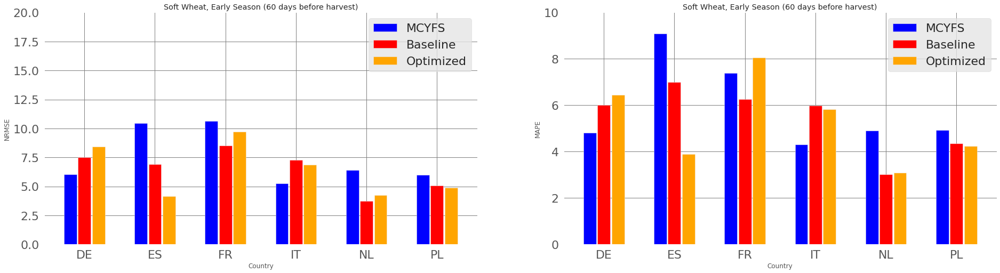

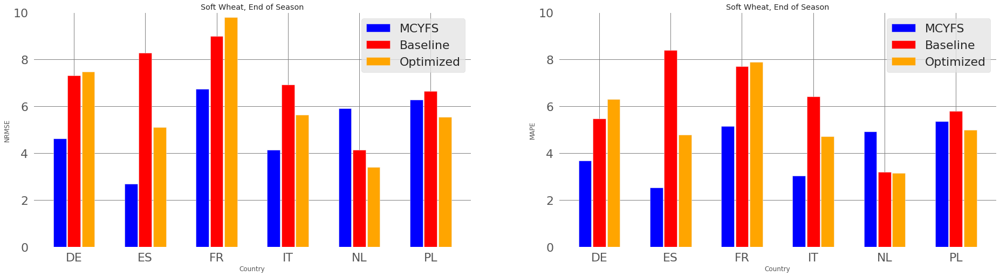

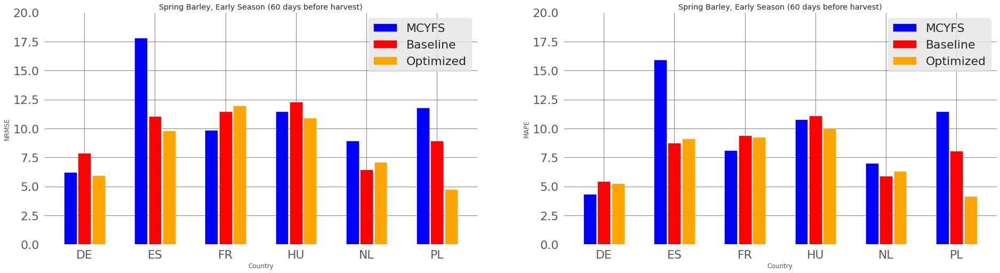

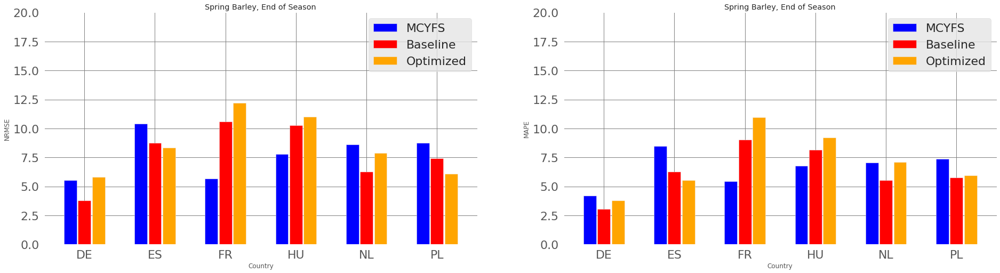

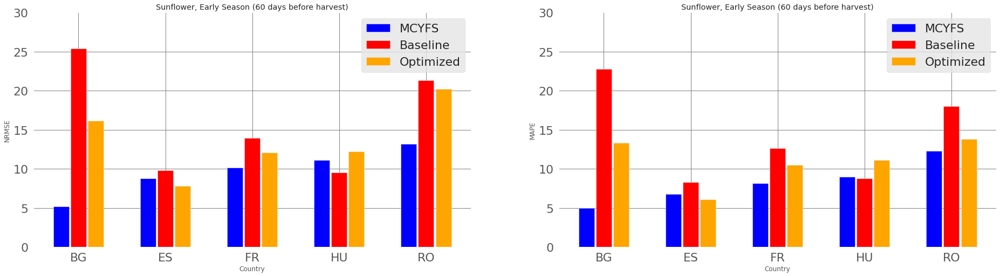

...

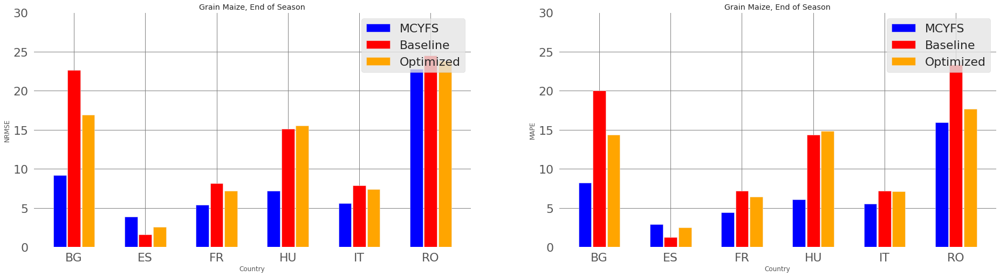

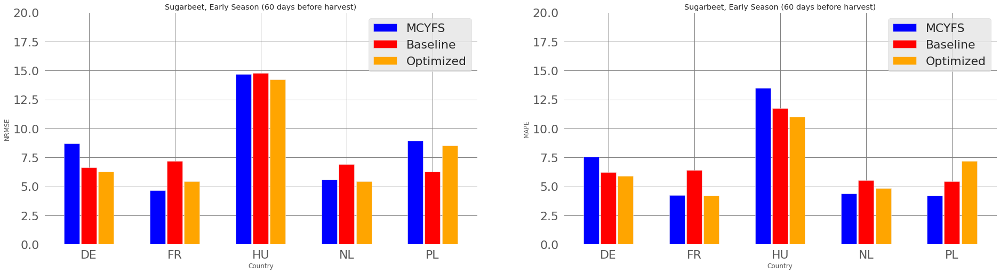

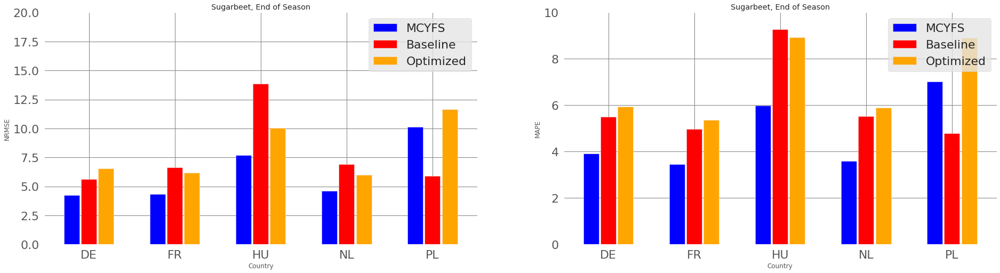

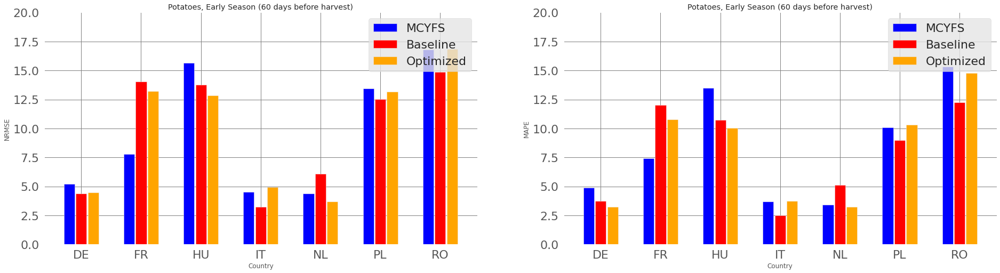

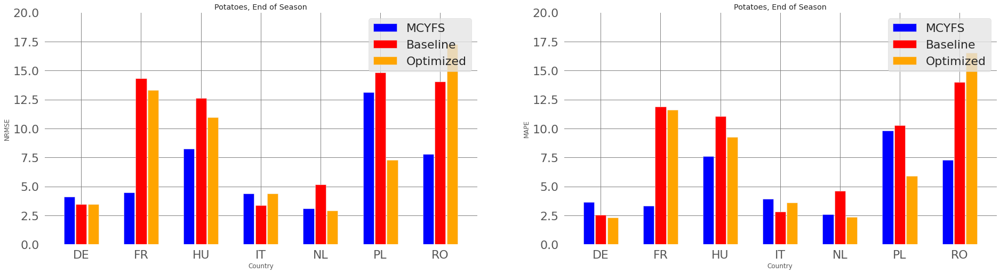

In [ ]:
%matplotlib inline
plt.style.use('ggplot')

crops = mlb_early6_sum_df['CROP'].unique()
metrics_names = ['NRMSE', 'MAPE']
bar_labels = ['MCYFS', 'Baseline', 'Optimized']

for cr in crops:
  # Early Season
  sel_mlb_early6_df = mlb_early6_sum_df[mlb_early6_sum_df['CROP'] == cr]
  sel_opt_early6_df = opt_early6_sum_df[opt_early6_sum_df['CROP'] == cr]
  crop_countries = sel_mlb_early6_df['COUNTRY'].unique()
  early_title = cr.title() + ', Early Season (60 days before harvest)'
  plotNUTS0SummaryMetrics(crop_countries, metrics_names, sel_mlb_early6_df, sel_opt_early6_df,
                          early_title, bar_labels)

  # End of Season
  sel_mlb_end_df = mlb_end_sum_df[mlb_end_sum_df['CROP'] == cr]
  sel_opt_end_df = opt_end_sum_df[opt_end_sum_df['CROP'] == cr]
  end_title = cr.title() + ', End of Season'
  plotNUTS0SummaryMetrics(crop_countries, metrics_names, sel_mlb_end_df, sel_opt_end_df,
                          end_title, bar_labels)

### Predicted vs observed

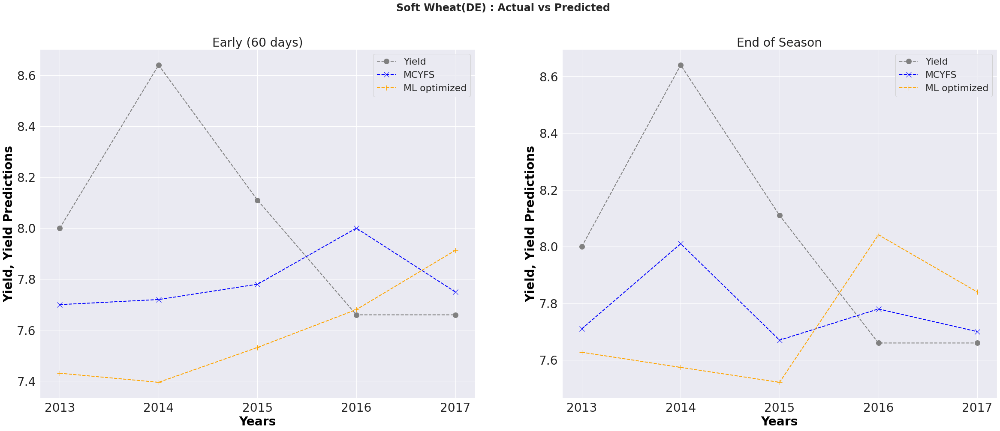

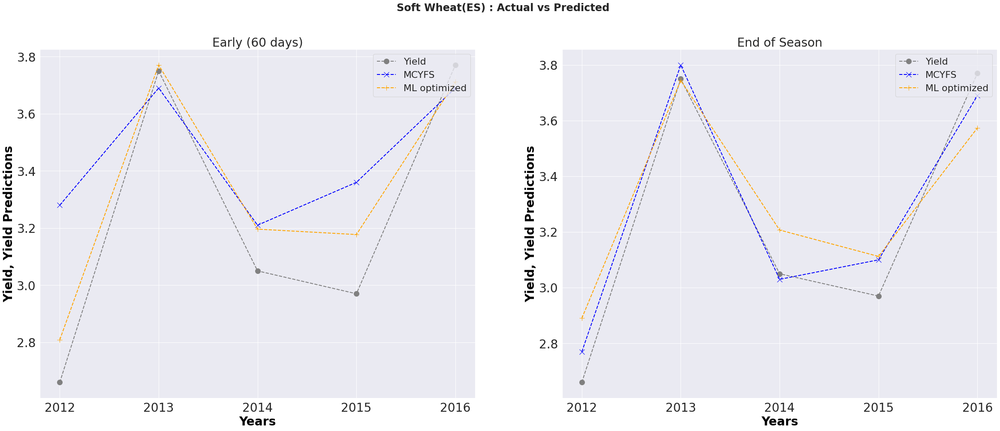

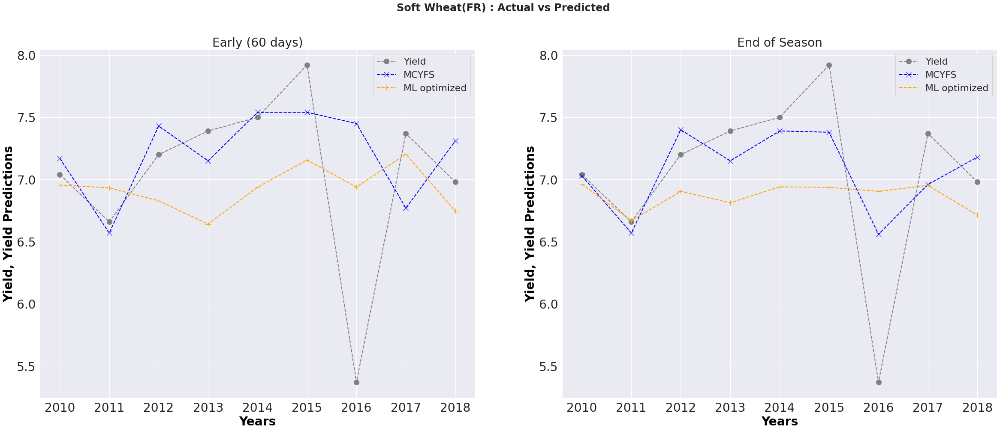

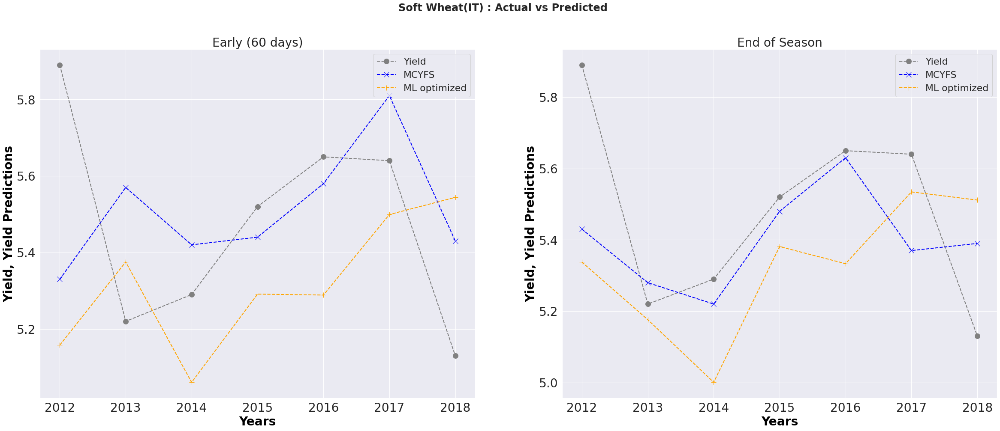

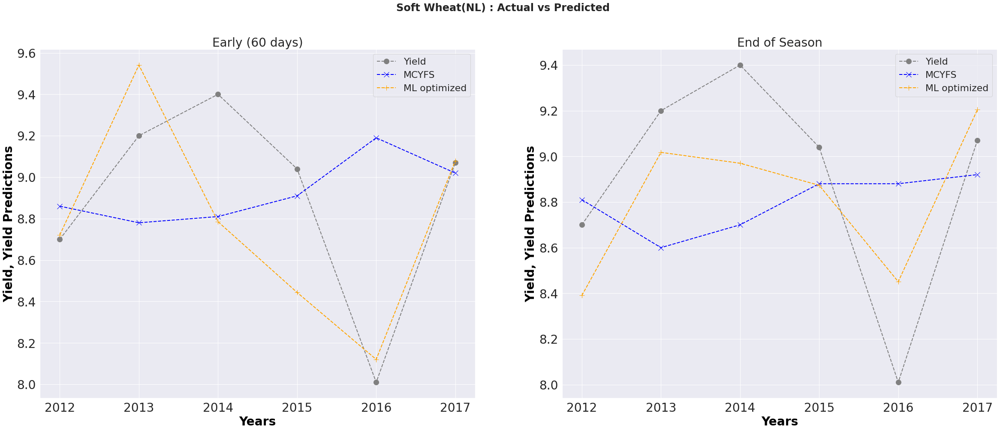

...

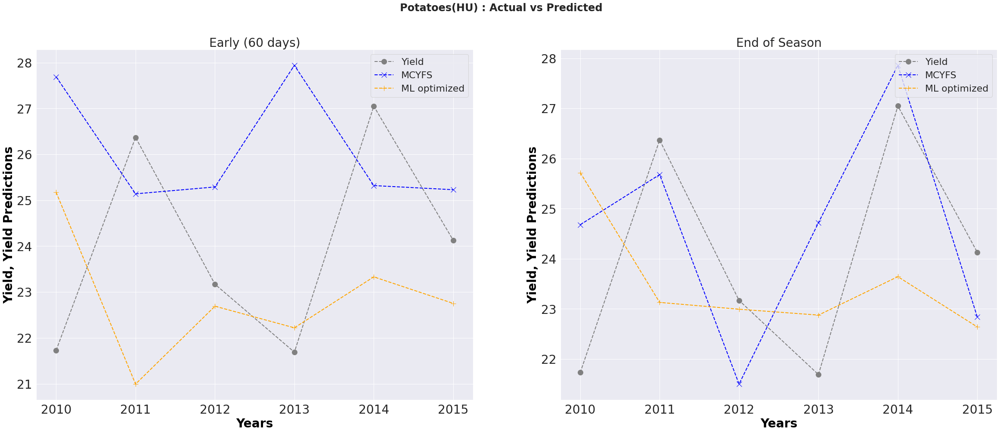

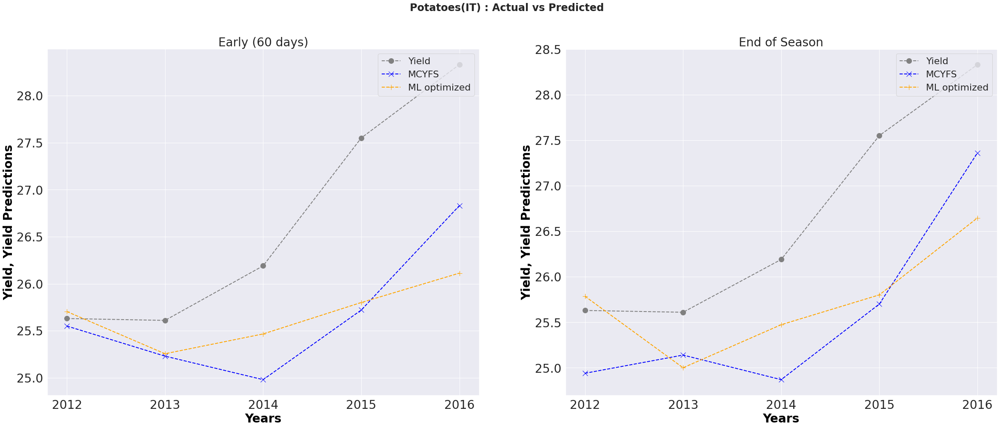

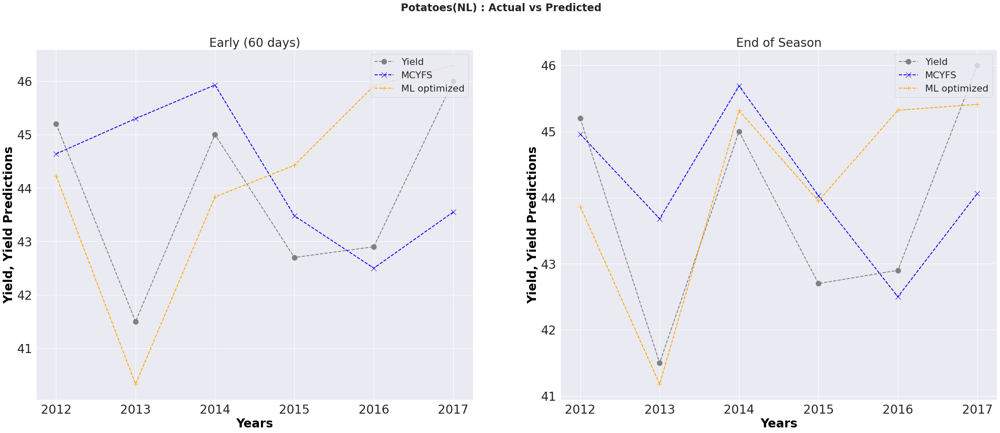

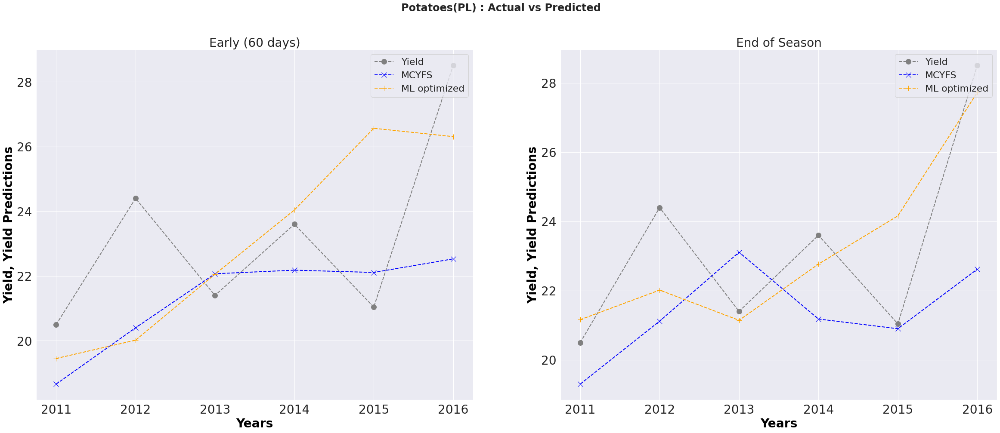

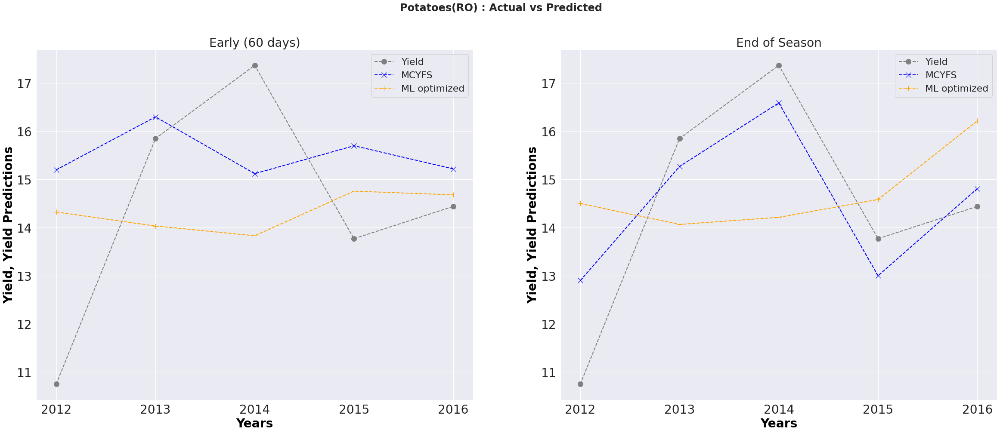

In [ ]:
crops = mlb_early6_sum_df['CROP'].unique()
summary_dfs_early = [mlb_early6_sum_df, opt_early6_sum_df]
summary_dfs_end = [mlb_end_sum_df, opt_end_sum_df]

for cr in crops:
  crop_mlb_early6_df = mlb_early6_dfs[cr]
  crop_opt_early6_df = opt_early6_dfs[cr]
  crop_mlb_end_df = mlb_end_dfs[cr]
  crop_opt_end_df = opt_end_dfs[cr]

  crop_countries = crop_opt_early6_df['COUNTRY'].unique()
  for cn in crop_countries:
    mlb_cn_early6_df = crop_mlb_early6_df[crop_mlb_early6_df['COUNTRY'] == cn]
    opt_cn_early6_df = crop_opt_early6_df[crop_opt_early6_df['COUNTRY'] == cn]
    mlb_cn_end_df = crop_mlb_end_df[crop_mlb_end_df['COUNTRY'] == cn]
    opt_cn_end_df = crop_opt_end_df[crop_opt_end_df['COUNTRY'] == cn]
    labels_early = [ '\n ML Baseline, Early (60 days)', '\n ML Optimized, Early (60 days)' ]
    labels_end = [ '\n ML Baseline, End of Season', '\n ML Optimized, End of Season' ]

    pred_early_dfs = [mlb_cn_early6_df, opt_cn_early6_df]
    pred_end_dfs = [mlb_cn_end_df, opt_cn_end_df]
    title_labels = ['Early (60 days)', 'End of Season']
    sel_ml_algs_early = getSelectedMLAlgorithmMulti(cr, cn, summary_dfs_early,
                                                    debug_level, labels_early)
    sel_ml_algs_end = getSelectedMLAlgorithmMulti(cr, cn, summary_dfs_end,
                                                  debug_level, labels_end)

    plotNUTS0ReportedVSPredicted(cr, cn, [pred_early_dfs, pred_end_dfs],
                                 [sel_ml_algs_early, sel_ml_algs_end], 'optimized',
                                 title_labels)

### Residuals Box plots

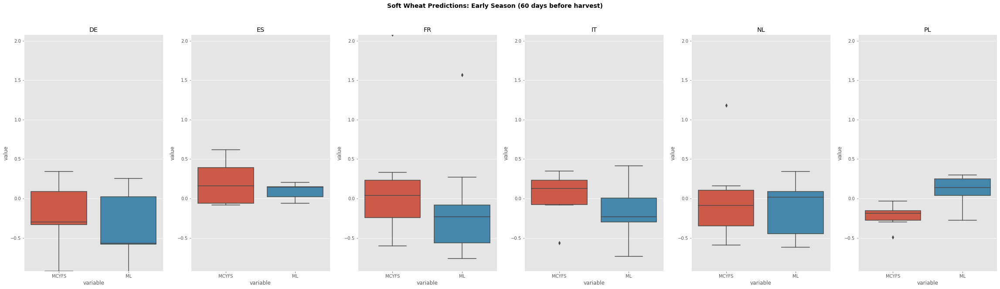

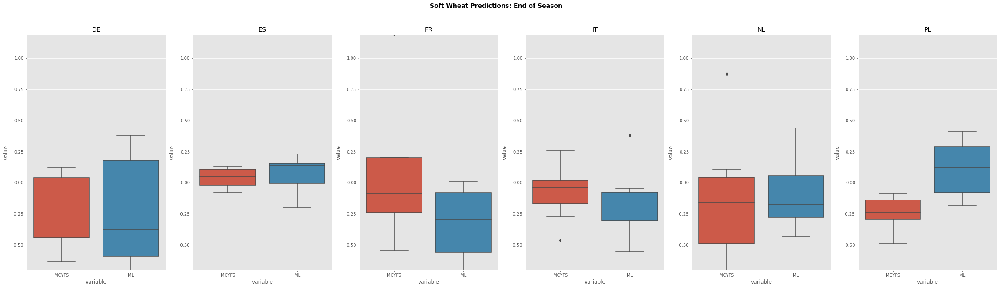

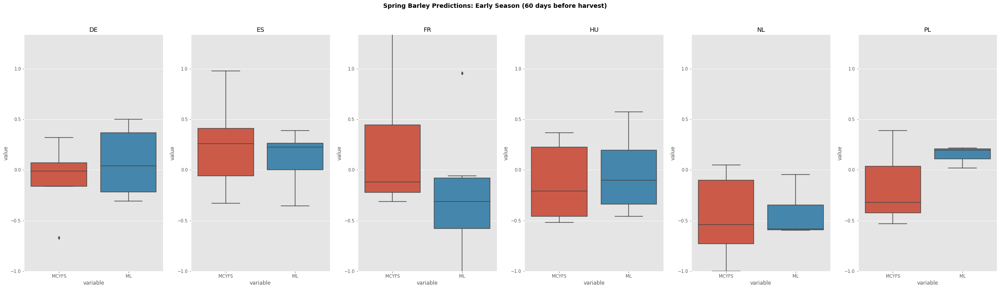

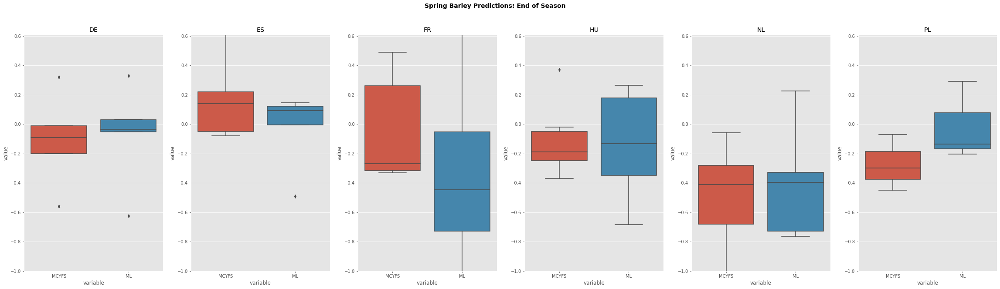

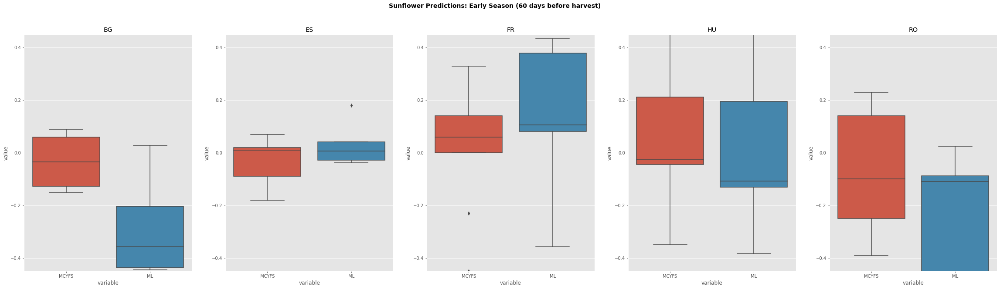

...

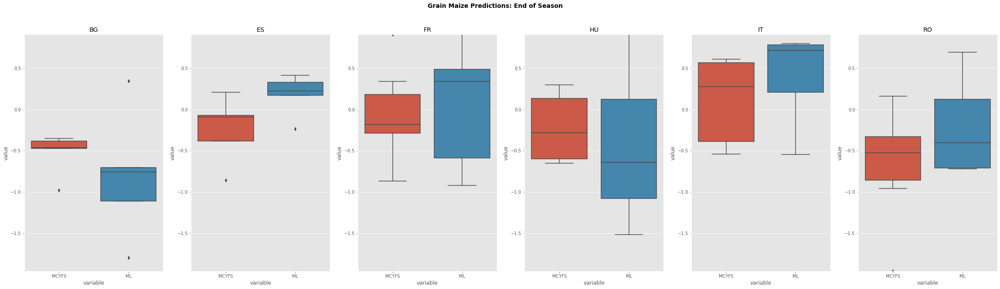

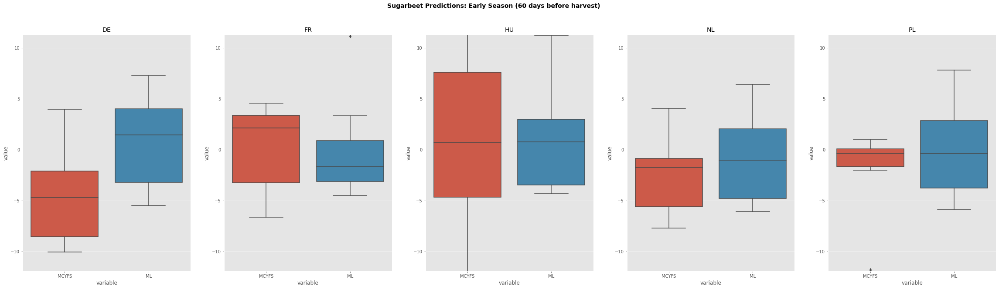

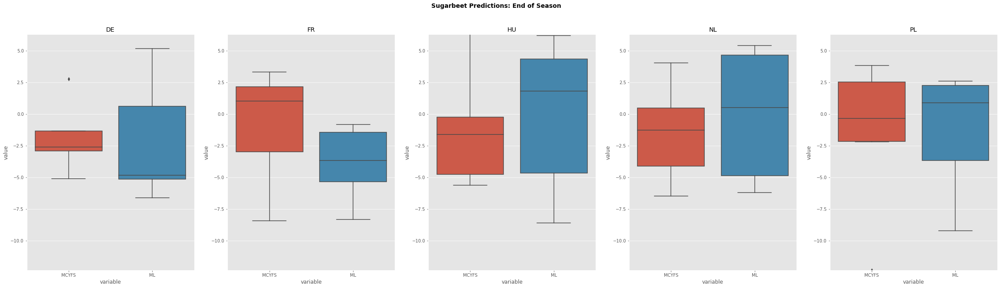

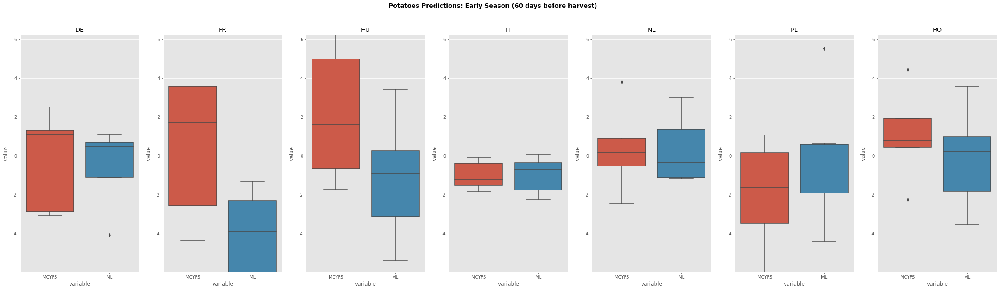

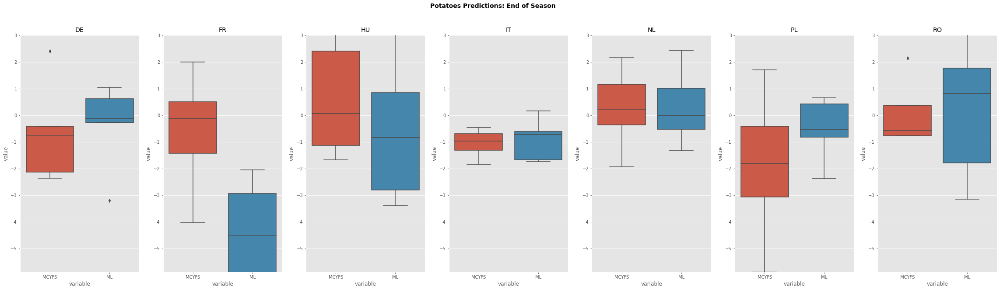

In [ ]:
crops = mlb_early6_sum_df['CROP'].unique()

summary_dfs_early = [mlb_early6_sum_df, opt_early6_sum_df]
summary_dfs_end = [mlb_end_sum_df, opt_end_sum_df]
for cr in crops:
  # crop_mlb_early6_df = mlb_early6_dfs[cr]
  crop_opt_early6_df = opt_early6_dfs[cr]
  # crop_mlb_end_df = mlb_end_dfs[cr]
  crop_opt_end_df = opt_end_dfs[cr]
  crop_countries = crop_opt_early6_df['COUNTRY'].unique()

  early6_title_label = 'Early Season (60 days before harvest)'
  # mlb_early6_ml_algs = {}
  opt_early6_ml_algs = {}
  for cn in crop_countries:
    # mlb_early6_ml_algs[cn] = getSelectedMLAlgorithm(cr, cn, mlb_early6_sum_df,
    #                                                 debug_level, early6_title_label)
    opt_early6_ml_algs[cn] = getSelectedMLAlgorithm(cr, cn, opt_early6_sum_df,
                                                    debug_level, early6_title_label)

  NUTS0ResidualBoxPlots(cr, crop_countries, crop_opt_early6_df, opt_early6_ml_algs,
                        early6_title_label)

  end_title_label = 'End of Season'
  # mlb_end_ml_algs = {}
  opt_end_ml_algs = {}
  for cn in crop_countries:
    # mlb_end_ml_algs[cn] = getSelectedMLAlgorithm(cr, cn, mlb_end_sum_df,
    #                                              debug_level, end_title_label)
    opt_end_ml_algs[cn] = getSelectedMLAlgorithm(cr, cn, opt_end_sum_df,
                                                 debug_level, end_title_label)

  NUTS0ResidualBoxPlots(cr, crop_countries, crop_opt_end_df, opt_end_ml_algs,
                        end_title_label)

## Plot NUTS0 maps

### Load and filter data

In [ ]:
import numpy as np
import pandas as pd
import geopandas as gpd
import matplotlib.pyplot as plt
import folium
from pathlib import Path

from sklearn.metrics import mean_squared_error
from sklearn.metrics import mean_absolute_error
from sklearn.metrics import r2_score

crop = 'soft wheat'
debug_level = 2
country_nuts = {
    'BG' : 'NUTS2',
    'DE' : 'NUTS3',
    'ES' : 'NUTS3',
    'FR' : 'NUTS3',
    'HU' : 'NUTS3',
    'IT' : 'NUTS3',
    'NL' : 'NUTS2',
    'PL' : 'NUTS2',
    'RO' : 'NUTS3',
}

metrics_functions = {
    # MAE (y_true, y_obs) = ( 1 / n ) * sum_i-n ( | y_true_i - y_obs_i | )
    # 'MAE' : mean_absolute_error,
    # MAPE (y_true, y_obs) = ( 1 / n ) * sum_i-n ( ( y_true_i - y_obs_i ) / y_true_i )
    'MAPE' : meanAbsolutePercentageError,
    # MSE (y_true, y_obs) = ( 1 / n ) * sum_i-n ( y_true_i - y_obs_i )^2
    'RMSE' : mean_squared_error,
    # R2 (y_true, y_obs) = 1 - ( ( sum_i-n ( y_true_i - y_obs_i )^2 )
    #                           / sum_i-n ( y_true_i - mean(y_true) )^2)
    'R2' : r2_score,
}

# same order as above
metrics_names = ['MAPE', 'NRMSE', 'R2']
ml_algorithms = ['Ridge', 'KNN', 'SVR', 'GBDT']
summary_columns = ['CROP', 'COUNTRY', 'ALGORITHM'] + metrics_names

countries_nuts0 = list(country_nuts.keys())
geo_pd_all_df = getNUTSGeoPandasData(countries_nuts0, 'NUTS0')

map_limits = {
    'xmin' : -10, 'xmax' : 30,
    'ymin' : 35, 'ymax' : 60,
}

country_xy = {
    'BG' : [25.0, 42.5],
    'DE' : [10.0, 51.0],
    'ES' : [-4.0, 41.0],
    'FR' : [2.0, 47.0],
    'HU' : [19.0, 46.5],
    'IT' : [11.0, 44.0],
    'NL' : [5.5, 52.5],
    'PL' : [18.0, 52.0],
    'RO' : [25.0, 45.5],
}

pd_preds_all_df = None
sel_ml_algs = {}
predictions_dir = 'optimized'

for cn in country_nuts:
  nuts_level = 'NUTS0'
  pd_preds_df = getMLPredictionsCropCountry(predictions_dir, crop, cn,
                                            nuts_level, debug_level=debug_level)
  if (pd_preds_df is None):
    continue

  pd_preds_df, ml_alg = selectMinRMSEMLAlgorithm(crop, cn, nuts_level,
                                                 pd_preds_df, ml_algorithms,
                                                 metrics_functions, summary_columns)
  sel_ml_algs[cn] = ml_alg
  if (pd_preds_all_df is None):
    pd_preds_all_df = pd_preds_df
  else:
    pd_preds_all_df = pd_preds_all_df.append(pd_preds_df)

geo_pd_all_df['COUNTRY'] = geo_pd_all_df['NUTS_ID'].str[:2]

print(geo_pd_all_df.head(5))
print(pd_preds_all_df.head(5).to_string(index=False))

fig_title = crop.title() + ' ('
countries = pd_preds_all_df['COUNTRY'].unique()
for cn in countries:
  fig_title += cn + ', '

fig_title = fig_title[:-2] + ')'

   NUTS_ID  ...                                           geometry
0       BG  ...  POLYGON ((22.99717 43.80787, 23.05372 43.79691...
7       DE  ...  MULTIPOLYGON (((9.11310 54.87360, 9.17943 54.8...
11      ES  ...  MULTIPOLYGON (((-7.69974 43.73512, -7.68257 43...
14      FR  ...  MULTIPOLYGON (((2.54601 51.08938, 2.57826 51.0...
15      HU  ...  MULTIPOLYGON (((22.12108 48.37831, 22.15531 48...

[5 rows x 8 columns]
NUTS_ID  FYEAR  YIELD_PRED_MCYFS  YIELD_PRED  YIELD  MCYFS_RES   PRED_RES COUNTRY
     DE   2013              7.71    7.627417   8.00  -3.625000  -4.657288      DE
     DE   2014              8.01    7.573977   8.64  -7.291668 -12.338234      DE
     DE   2015              7.67    7.521410   8.11  -5.425396  -7.257582      DE
     DE   2016              7.78    8.041379   7.66   1.566584   4.978843      DE
     DE   2017              7.70    7.839903   7.66   0.522193   2.348604      DE


### Average Yield Residual for Test Years

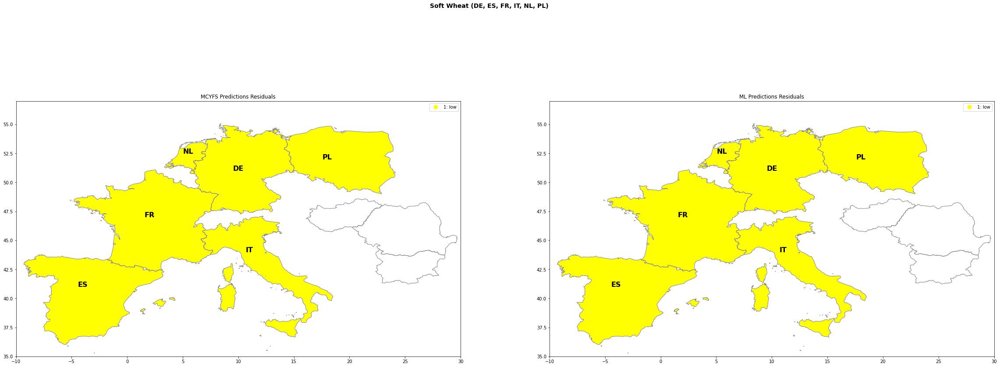

In [ ]:
plotNUTS0AvgYieldResiduals(pd_preds_all_df, geo_pd_all_df,
                           map_limits, country_xy, fig_title)

### Per Year Yield Residuals Interactive

In [ ]:
def warn(*args, **kwargs):
    pass

import warnings
warnings.warn = warn

test_years = sorted(pd_preds_all_df['FYEAR'].unique())

print('MCYFS predictions residuals')
plotInteractiveResidualsMap(pd_preds_all_df, test_years, geo_pd_all_df,
                            'MCYFS_RES', fig_title)

print('ML predictions residuals')
plotInteractiveResidualsMap(pd_preds_all_df, test_years, geo_pd_all_df,
                            'PRED_RES', fig_title)

### Per Year Yield Residuals Static

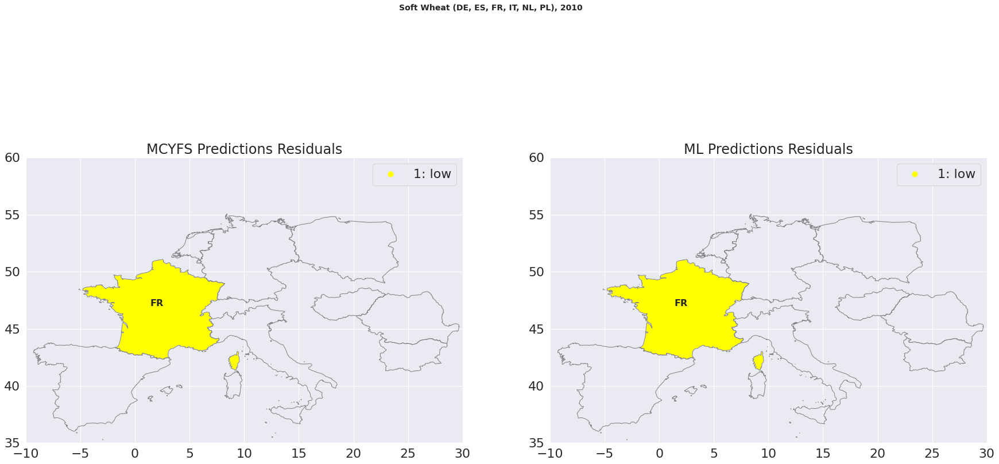

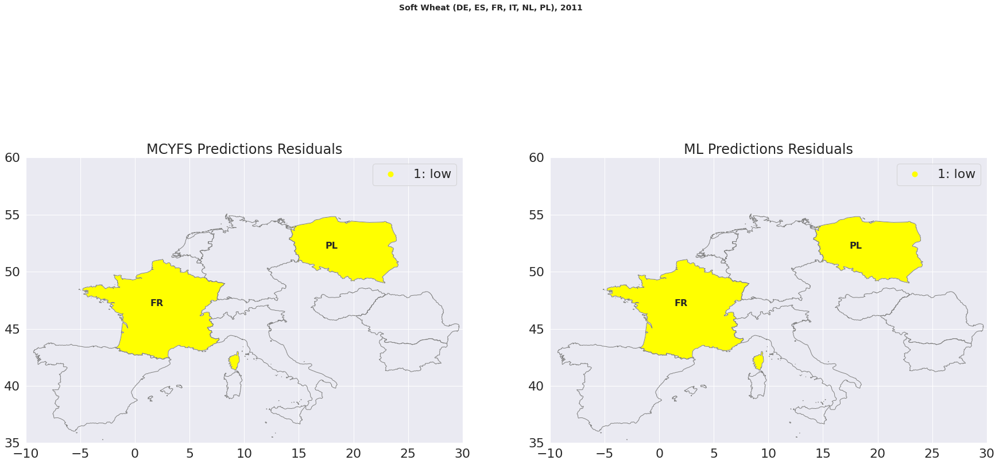

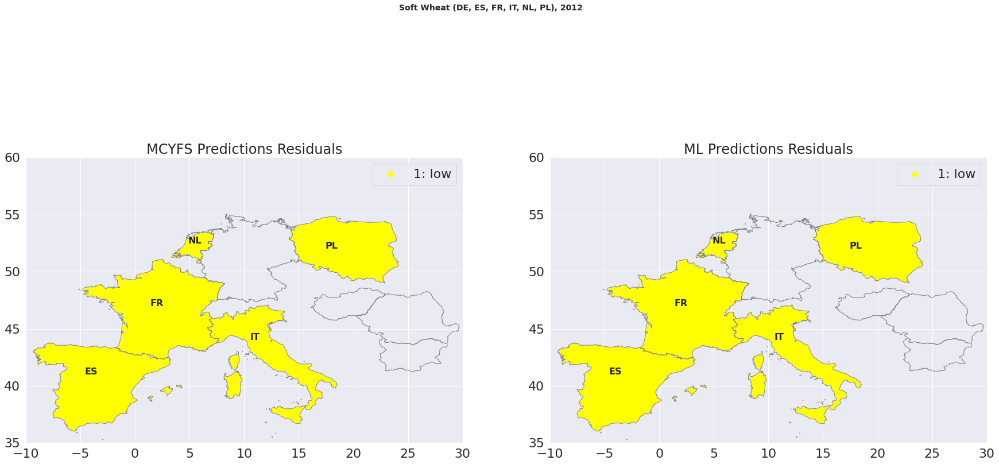

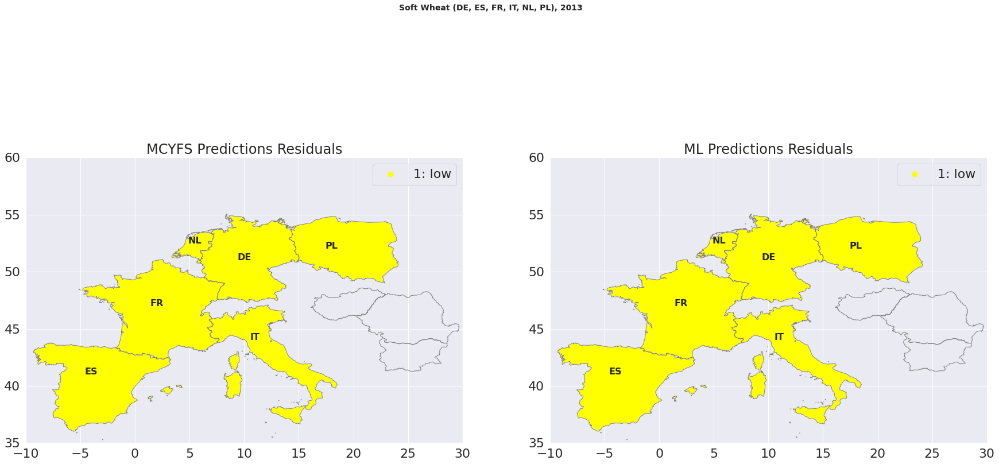

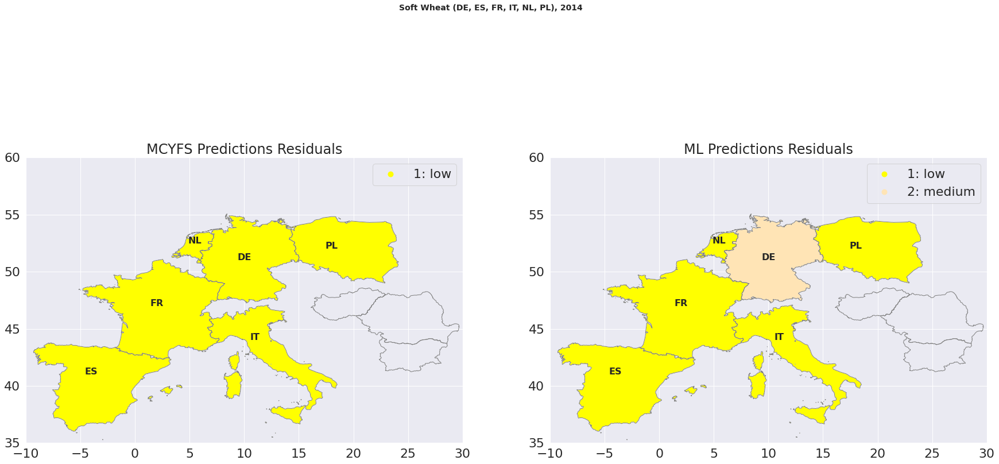

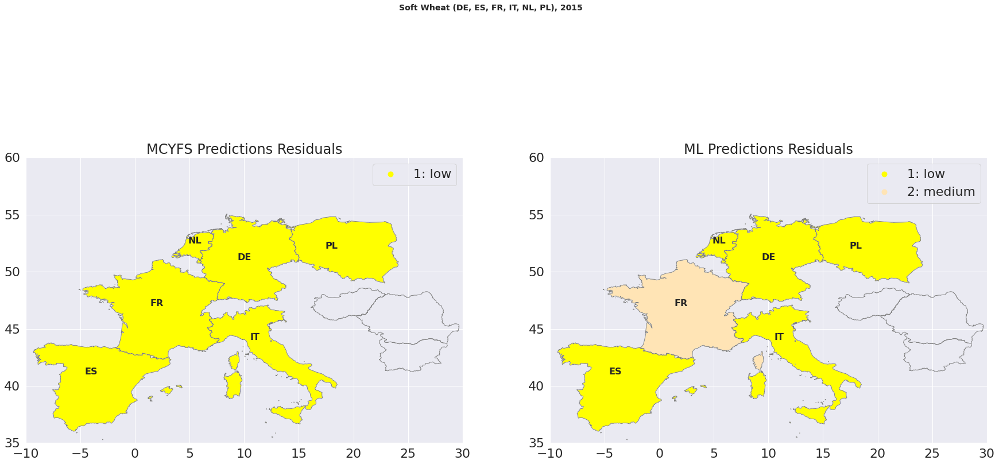

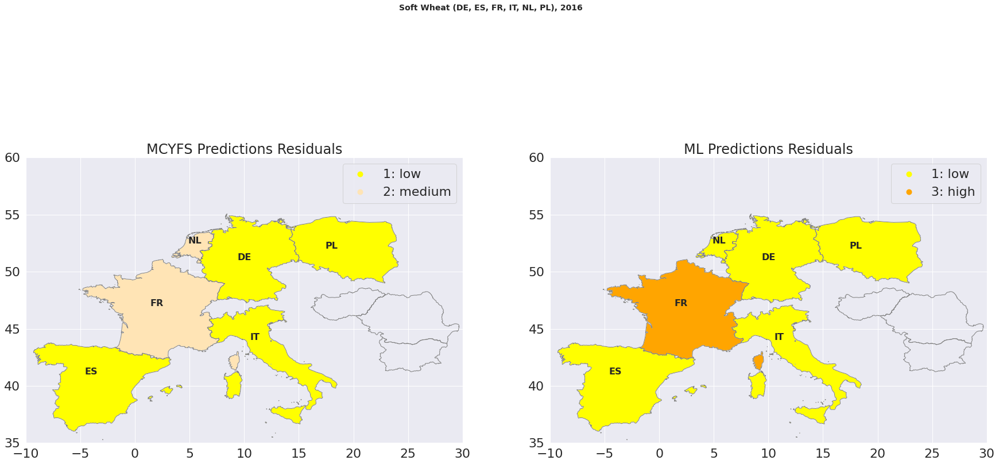

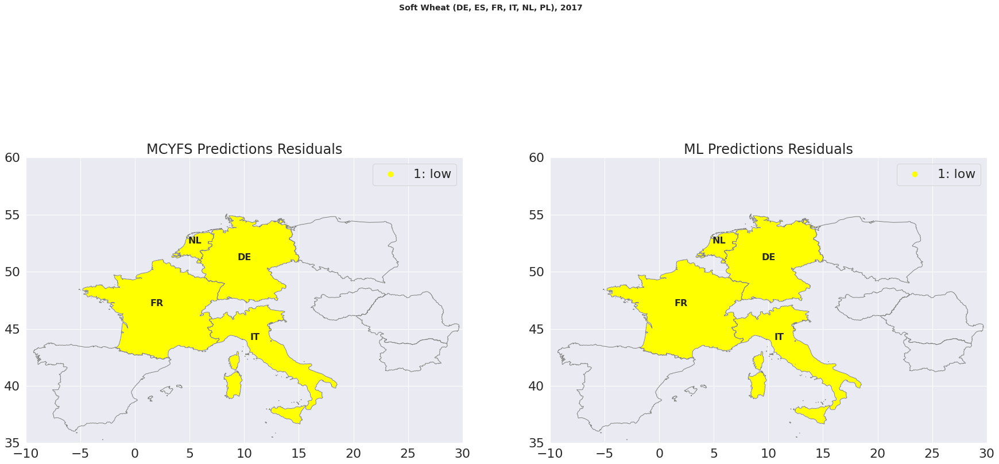

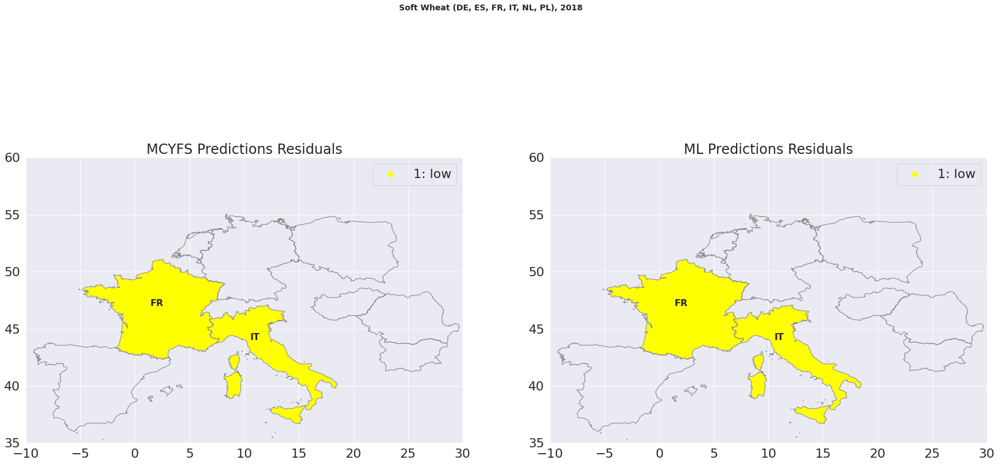

In [ ]:
col_names = ['MCYFS_RES', 'PRED_RES']
col_labels = ['MCYFS Predictions Residuals', 'ML Predictions Residuals']
plotStaticResidualsMaps(pd_preds_all_df, test_years,
                        geo_pd_all_df, geo_pd_all_df,
                        map_limits, country_xy,
                        col_names, col_labels, fig_title)

### Predicted yield vs Observed Interactive

In [ ]:
def warn(*args, **kwargs):
    pass

import warnings
warnings.warn = warn

test_years = sorted(pd_preds_all_df['FYEAR'].unique())

show_cols = ['YIELD', 'YIELD_PRED']
crop_countries = sorted(pd_preds_all_df['COUNTRY'].unique())
country_conditions = [pd_preds_all_df['COUNTRY'] == cn for cn in crop_countries]
country_mins = []
country_maxs = []
country_ranges = []
for cn in crop_countries:
  cn_min = min([pd_preds_all_df[pd_preds_all_df['COUNTRY'] == cn][c].min() for c in show_cols])
  cn_max = max([pd_preds_all_df[pd_preds_all_df['COUNTRY'] == cn][c].max() for c in show_cols])
  country_mins.append(cn_min)
  country_maxs.append(cn_max)
  country_ranges.append(cn_max - cn_min)

pd_preds_all_df['CN_MIN'] = np.select(country_conditions, country_mins)
pd_preds_all_df['CN_MAX'] = np.select(country_conditions, country_maxs)
pd_preds_all_df['CN_RANGE'] = np.select(country_conditions, country_ranges)
for c in show_cols:
  pd_preds_all_df[c + '_SCALED'] = (pd_preds_all_df[c] - pd_preds_all_df['CN_MIN'])/pd_preds_all_df['CN_RANGE']

print('Yield Statistics')
plotInteractiveMap(pd_preds_all_df, test_years, geo_pd_all_df,
                   'YIELD', fig_title)

# print('MCYFS Predictions')
# plotInteractiveMap(pd_preds_all_df, test_years, geo_pd_all_df,
#                    'YIELD_PRED', fig_title)

print('ML predictions')
plotInteractiveMap(pd_preds_all_df, test_years, geo_pd_all_df,
                   'YIELD_PRED', fig_title)

### Predicted vs Observed Static

In [ ]:
# show_cols = ['YIELD', 'YIELD_PRED_MCYFS', 'YIELD_PRED']
# col_labels = ['Yield Statistics', 'MCYFS Predictions', 'ML Predictions']

show_cols = ['YIELD', 'YIELD_PRED']
col_labels = ['Yield Statistics', 'ML Predictions']

if ('CN_RANGE' not in pd_preds_all_df.columns):
  crop_countries = sorted(pd_preds_all_df['COUNTRY'].unique())
  country_conditions = [pd_preds_all_df['COUNTRY'] == cn for cn in crop_countries]
  country_mins = []
  country_maxs = []
  country_ranges = []
  for cn in crop_countries:
    cn_min = min([pd_preds_all_df[pd_preds_all_df['COUNTRY'] == cn][c].min() for c in show_cols])
    cn_max = max([pd_preds_all_df[pd_preds_all_df['COUNTRY'] == cn][c].max() for c in show_cols])
    country_mins.append(cn_min)
    country_maxs.append(cn_max)
    country_ranges.append(cn_max - cn_min)

  pd_preds_all_df['CN_MIN'] = np.select(country_conditions, country_mins)
  pd_preds_all_df['CN_MAX'] = np.select(country_conditions, country_maxs)
  pd_preds_all_df['CN_RANGE'] = np.select(country_conditions, country_ranges)
  for c in show_cols:
    pd_preds_all_df[c + '_SCALED'] = (pd_preds_all_df[c] - pd_preds_all_df['CN_MIN'])/pd_preds_all_df['CN_RANGE']

plotStaticMaps(pd_preds_all_df, test_years, geo_pd_all_df, geo_pd_all_df,
               map_limits, country_xy, show_cols, col_labels, fig_title)